<a href="https://colab.research.google.com/github/jomarca11/On-Line-Machine-Learning/blob/main/TFM_Largo_Plazo.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from river import drift
from river import time_series, evaluate
from river import datasets,compose
from river import linear_model,tree,preprocessing,optim
import calendar,math, datetime as dt

## 2.2 Predicciones a Largo Plazo
En este apartado vamos a realizar las tareas relacionadas con las Previsiones a largo Plazo. Aquí vamos a establecer tres horizontes temporales. Un horizonte temporal de 1 mes, 2 meses  y otro horizonte temporal de 3 meses. 


### 2.2.1 Aquí definiremos las librerias y métodos necesarios. 
La librería utilizada como en el resto de trabajo, es la riverML, pero en este caso vamos a sobreescribir el método iter_evaluate para adaptar al tratamiento del concept drift cuando este, esté presente.

In [ ]:
#cargamos los datos de nuevo para independizarlo del resto del notebook
data_orig = pd.read_csv('C:/Users/jrmr/Master/TFM/PEC3/hungary_chickenpox/hungary_chickenpox.csv')
data_orig['Date'] = pd.to_datetime(data_orig['Date'],format="%d/%m/%Y") # convertimos a fecha
data_orig.set_index('Date', inplace=True)
label_num_casos ="Num. Casos"

In [ ]:
#Si se definen alguna librería varias veces es para no tener que ejecutar todo el código cada vez se hace una prueba
from river import time_series, evaluate
from river import compose
from river import linear_model,tree,preprocessing,optim
import calendar,math, datetime as dt
from river import metrics,base
import typing, statistics
from river.time_series.evaluate import _iter_with_horizon

df_datos_largo_plazo=pd.DataFrame(columns=data_orig.columns)
#Dataframes para recoger los errores y mostrarlos en las gráficas sin tener en cuenta los outliers
df_error_mae_un_mes=pd.DataFrame(columns=data_orig.columns)
df_error_mae_dos_meses=pd.DataFrame(columns=data_orig.columns)
df_error_mae_tres_meses=pd.DataFrame(columns=data_orig.columns)


#Dataframes para recoger los errores y mostrarlos en las gráficas considerando los outliers
df_error_mae_un_mes_sin_outliers=pd.DataFrame(columns=data_orig.columns)
df_error_mae_dos_meses_sin_outliers=pd.DataFrame(columns=data_orig.columns)
df_error_mae_tres_meses_sin_outliers=pd.DataFrame(columns=data_orig.columns)


#Dataframes para recoger los errores base line y mostrarlos en las gráficas sin tener en cuenta los outliers
df_error_mae_un_mes_baseline=pd.DataFrame(columns=data_orig.columns)
df_error_mae_dos_meses_baseline=pd.DataFrame(columns=data_orig.columns)
df_error_mae_tres_meses_baseline=pd.DataFrame(columns=data_orig.columns)


#Dataframes para recoger los errores base line y mostrarlos en las gráficas considerando los outliers
df_error_mae_un_mes_sin_outliers_baseline=pd.DataFrame(columns=data_orig.columns)
df_error_mae_dos_meses_sin_outliers_baseline=pd.DataFrame(columns=data_orig.columns)
df_error_mae_tres_meses_sin_outliers_baseline=pd.DataFrame(columns=data_orig.columns)


def get_ordinal_date(x):
    """Returns the ordinal date of a given x date
    """     
    return {'ordinal_date': x.toordinal()}

#definimos el modelo ya ajustado con sus hiperparámetros
model_dummy=time_series.HoltWinters(alpha=0.6,beta=0.04,gamma=0.9)

#Definimos el modelo SNARIMAX, que generaliza muchos modelos de series temporales en una unica interface y puede ser entrenado online
model_s = (
      get_ordinal_date|
     time_series.SNARIMAX(
         p=4,
         d=0,
         q=9,
         m=52,
         sp=4,
         sq=9,
         regressor=(
             preprocessing.StandardScaler() | 
             linear_model.LinearRegression(
                 intercept_init=110,
                 optimizer=optim.SGD(0.001),
                 intercept_lr=0.3
             )
         )
     )
 )

#Redefinimos el metodo iter_evaluate, para poder sacar las métricas y crear la tabla de resultados y las gráficas, solo para tratar outliers o
def iter_evaluate(
    dataset: base.typing.Dataset,
    model: time_series.base.Forecaster,
    metric: metrics.base.RegressionMetric,
    horizon: int,
    agg_func: typing.Callable[[list[float]], float] = None,
    grace_period: int = None,
    outlier_value=0
):
    """Evaluates the performance of a forecaster on a time series dataset and yields results.
    This does exactly the same as `evaluate.progressive_val_score`. The only difference is that
    this function returns an iterator, yielding results at every step. This can be useful if you
    want to have control over what you do with the results. For instance, you might want to plot
    the results.
    Parameters
    ----------
    @dataset
        A sequential time series.
    @model
        A forecaster.
    @metric
        A regression metric.
    @horizon : time horizon to forecast
    @agg_func :function to aggregate the error metrics [mean,.. ]
    @grace_period
        Initial period during which the metric is not updated. This is to fairly evaluate models
        which need a warming up period to start producing meaningful forecasts. The value of this
        parameter is equal to the horizon by default.
    @outlier value
        if >0 it means handling the outliers

    """
   
    horizon_metric = (
        time_series.HorizonAggMetric(metric, agg_func)
        if agg_func
        else time_series.HorizonMetric(metric)
    )
    steps = _iter_with_horizon(dataset, horizon)
    num_outliers=0
    #y_horizon =la ground truth en el horizonte
    grace_period = horizon if grace_period is None else grace_period
    
    for _ in range(grace_period):
      
        x, y, x_horizon, y_horizon = next(steps)
        if (y>outlier_value and outlier_value>0):
          None
        else:
          model.learn_one(y=y, x=x)  # type: ignore

    
    if (outlier_value>0):#si queremos checker los outliers
      for x, y, x_horizon, y_horizon in steps:
        
          if (y>outlier_value):
              #num_outliers+=1
              None
          else:
            y_pred = model.forecast(horizon, xs=x_horizon)
            horizon_metric.update(y_horizon, y_pred)
            model.learn_one(y=y, x=x)  # type: ignore
            yield x, y, y_pred, horizon_metric,num_outliers
    else:
         for x, y, x_horizon, y_horizon in steps:
            y_pred = model.forecast(horizon, xs=x_horizon)
            horizon_metric.update(y_horizon, y_pred)
            model.learn_one(y=y, x=x)  # type: ignore
            yield x, y, y_pred, horizon_metric#,num_outliers #aqui el num de outliers sera 0 siempre, pero por igualar datos devueltos
          

#Redefinimos el metodo iter_evaluate para tratar el drift
def iter_evaluate_with_drift(
    dataset: base.typing.Dataset,
    model: time_series.base.Forecaster,
    metric: metrics.base.RegressionMetric,
    horizon: int,
    agg_func: typing.Callable[[list[float]], float] = None,
    grace_period: int = None,
    outlier_value=0,
    check_drift=False,
    model_to_check="snarimax"
):
    """Evaluates the performance of a forecaster on a time series dataset and yields results.
    This does exactly the same as `evaluate.progressive_val_score`. The only difference is that
    this function returns an iterator, yielding results at every step. This can be useful if you
    want to have control over what you do with the results. For instance, you might want to plot
    the results.
    Parameters
    ----------
    @dataset
        A sequential time series.
    @model
        A forecaster.
    @metric
        A regression metric.
   @horizon : time horizon to forecast
   @agg_func :function to aggregate the error metrics [mean,.. ]
  @grace_period
        Initial period during which the metric is not updated. This is to fairly evaluate models
        which need a warming up period to start producing meaningful forecasts. The value of this
        parameter is equal to the horizon by default.
    @outlier value
        if >0 it means handling the outliers, for this version of iter_evaluate_with drift outlier_value always greater than 0
    @check_drift: if drift has to be checked or not
    @model_to_check: which model needs to be reset if drift occurs.
    """
       
    horizon_metric = (
        time_series.HorizonAggMetric(metric, agg_func)
        if agg_func
        else time_series.HorizonMetric(metric)
    )
    steps = _iter_with_horizon(dataset, horizon)
    
    #y_horizon =la ground truth en el horizonte
    grace_period = horizon if grace_period is None else grace_period

    adwin=drift.ADWIN(10)
    lista_drifts=[]
   
    for _ in range(grace_period):
      
        x, y, x_horizon, y_horizon = next(steps)
        if (y>outlier_value and outlier_value>0):
          None
        else:
          model.learn_one(y=y, x=x)  # type: ignore

    if check_drift==True:
      for x, y, x_horizon, y_horizon in steps:
        adwin.update(y)
        if adwin.drift_detected:
          adwin=drift.ADWIN(10)
          lista_drifts.append(x)
          if model_to_check=="snarimax":
            
            model= (
                    get_ordinal_date|
                  time_series.SNARIMAX(
                      p=4,
                      d=0,
                      q=9,
                      m=52,
                      sp=4,
                      sq=9,
                      regressor=(
                          preprocessing.StandardScaler() | 
                          linear_model.LinearRegression(
                              intercept_init=110,
                              optimizer=optim.SGD(0.001),
                              intercept_lr=0.3
                          )
                      )
                  )
              )
          else:
            model.clone()
        if (y<=outlier_value): #Solo contemplamos los valores que no son outliers
            model.learn_one(y=y, x=x)  # type: ignore
            y_pred = model.forecast(horizon, xs=x_horizon)
            horizon_metric.update(y_horizon, y_pred)
            yield x, y, y_pred, horizon_metric,lista_drifts
            
    else:
      
        for x, y, x_horizon, y_horizon in steps:
          if (y<=outlier_value):
            y_pred = model.forecast(horizon, xs=x_horizon)
            horizon_metric.update(y_horizon, y_pred)
            model.learn_one(y=y, x=x)  # type: ignore
            yield x, y, y_pred, horizon_metric,lista_drifts

#-------------------------------------------------------------------------------------#
#Método que entrena el modelo y crea las métricas
def evaluate_forecasting(modelo,data,ax,column,horizonte,outlier_value=0, model ='snarimax'):
    """Evaluates the performance of a forecaster on a time series dataset and yields results, through iter_evaluate method
    and gathers metrics and plots the results predictions vs ground truth.
    This method is only intended for outliers. Handling outliers or not depending on the vlue of outlier_value
          
    Parameters
    ----------
    @dataset
        A sequential time series.
    @model
        A forecaster.
   
    @horizon horizon to forecast
    @outlier value
        if >0 it means handling the outliers
    @ax: axis where to plot predictions vs ground truth.
    @column: which data column is handled (Hungarian county)
    @model:label to handle error messages accordingly

    """
    metricas = iter_evaluate(
        dataset=data.T.iteritems(),
        model=modelo,
        metric=metrics.MAE(),
        horizon=horizonte,
        agg_func=statistics.mean,
        outlier_value=outlier_value
        )
    dates = []
    y_trues = []
    y_preds = []
    lista=[]
    
    horizon=horizonte
    mensaje=""
    mensaje_outliers=""
    num_outliers=0
    i=0
    if outlier_value==0:
      mensaje ="1 MAE Datos sin drift y sin tratar outliers con horizonte= "
      
    else:
      mensaje ="2 MAE Datos sin drift y tratando outliers con horizonte= "
       
    for m in metricas:
          dates.append(m[0])
          y_trues.append(m[1])
          y_preds.append(m[2][horizon-1])
          lista.append(m[3].get())
          #num_outliers=m[4]
          
          if model=='snarimax':
            if outlier_value >0:
              if horizonte==4:
                df_error_mae_un_mes.at[i,column] =round(m[3].get(),2)
              elif horizonte==8:
                df_error_mae_dos_meses.at[i,column] =round(m[3].get(),2)
              elif horizonte==12:
                df_error_mae_tres_meses.at[i,column] =round(m[3].get(),2)
            else:
              if horizonte==4:
                df_error_mae_un_mes_sin_outliers.at[i,column] =round(m[3].get(),2)
              elif horizonte==8:
                df_error_mae_dos_meses_sin_outliers.at[i,column] =round(m[3].get(),2)
              elif horizonte==12:
                df_error_mae_tres_meses_sin_outliers.at[i,column] =round(m[3].get(),2)
          else:
            if outlier_value >0:
              if horizonte==4:
                df_error_mae_un_mes_baseline.at[i,column] =round(m[3].get(),2)
              elif horizonte==8:
                df_error_mae_dos_meses_baseline.at[i,column] =round(m[3].get(),2)
              elif horizonte==12:
                df_error_mae_tres_meses_baseline.at[i,column] =round(m[3].get(),2)
            else:
              if horizonte==4:
                df_error_mae_un_mes_sin_outliers_baseline.at[i,column] =round(m[3].get(),2)
              elif horizonte==8:
                df_error_mae_dos_meses_sin_outliers_baseline.at[i,column] =round(m[3].get(),2)
              elif horizonte==12:
                df_error_mae_tres_meses_sin_outliers_baseline.at[i,column] =round(m[3].get(),2)

          i+=1
    metric=round(sum(lista)/len(lista),2) #average of MAES for one horizon forecast
    # Plot the results
    ax=ax
    ax.grid(alpha=0.75)
    ax.plot(dates, y_trues, lw=3, color='#2ecc71', alpha=0.8, label='Ground truth')
    ax.plot(dates, y_preds, lw=3, color='#e74c3c', alpha=0.8, label='Prediction')
    ax.legend()
    ax.set_title("MAE "+str(metric))
    ax.set_xlabel(column)
    ax.set_ylabel(label_num_casos)
    
    df_datos_largo_plazo.at[mensaje+ ' '+str(horizonte)+' semanas, modelo = '+model, column] = metric
 
    if outlier_value==0:
      std=round(data.std(),2)
      mean=round(data.mean(),2)
      df_datos_largo_plazo.at['STD', column] = std
      df_datos_largo_plazo.at['MEAN', column] = mean
      outlier_value= mean+(3*std)
      #Contador de outliers
      num_outliers=df_data[df_data>outlier_value].count()
      df_datos_largo_plazo.at['Num Outliers', column] = num_outliers


NameError: ignored

### 2.2.2 Gráficas de los diferentes modelos comparando las predicciones en el horizonte h, con los valores verdaderos h-t. 
Se puede comprobar como a mayor horizonte en la predicción la métrica de error seleccionada MAE aumenta. Con lo cual a mayor horizonte, menor precisión en la prediccion.

#### 2.2.2.1 Gráficas y comportamiento del modelo SNARIMAX con horizonte a 1 mes ( 4 semanas ).

##### 2.2.2.1.1 Gráfica y Comportamiento de la prediccion a 1 mes (4 semanas). Sin tratar los outliers.

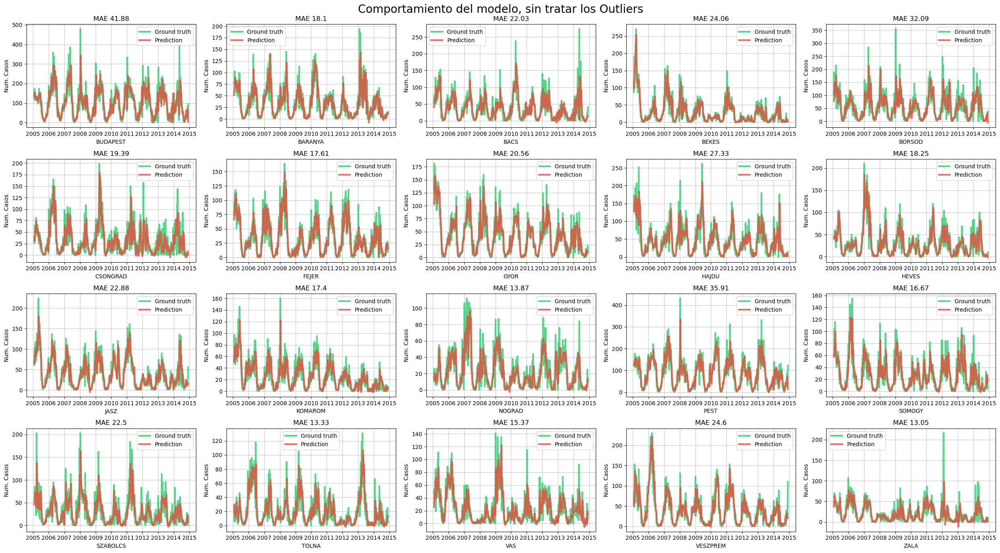

In [ ]:

fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= data_orig.iloc[:, i]
        media=df_data.mean()
        std=df_data.std()
        outlier_value=media+(3*std)
        model_dummy=time_series.HoltWinters(alpha=0.6,beta=0.04,gamma=0.9)
        label=data_orig.columns[i]
        model_s = ( get_ordinal_date|  time_series.SNARIMAX(
                p=4,
                d=0,
                q=9,
                m=52,
                sp=4,
                sq=9,
                regressor=(
                    preprocessing.StandardScaler() | 
                    linear_model.LinearRegression(
                        intercept_init=110,
                        optimizer=optim.SGD(0.001),
                        intercept_lr=0.3
                    )
                )
            )
        )
        evaluate_forecasting(model_s,df_data,ax,label,horizonte=4,outlier_value=0)
  
        i += 1
fig.suptitle("Comportamiento del modelo, sin tratar los Outliers", fontsize=20)
plt.tight_layout()
plt.show()

##### 2.2.2.1.2 Gráfica y Comportamiento de la prediccion a 1 mes (4 semanas). Tratando los outliers.

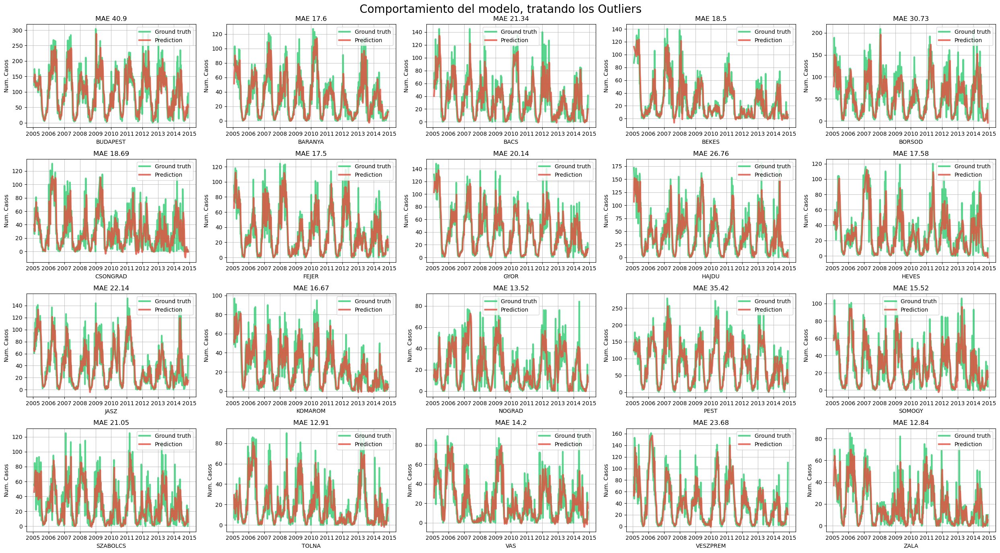

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= data_orig.iloc[:, i]
        media=df_data.mean()
        std=df_data.std()
        outlier_value=media+(3*std)
        model_dummy=time_series.HoltWinters(alpha=0.6,beta=0.04,gamma=0.9)
        label=data_orig.columns[i]
        model_s = ( get_ordinal_date|  time_series.SNARIMAX(
                p=4,
                d=0,
                q=9,
                m=52,
                sp=4,
                sq=9,
                regressor=(
                    preprocessing.StandardScaler() | 
                    linear_model.LinearRegression(
                        intercept_init=110,
                        optimizer=optim.SGD(0.001),
                        intercept_lr=0.3
                    )
                )
            )
        )
        evaluate_forecasting(model_s,df_data,ax,label,horizonte=4,outlier_value=outlier_value)
        #evaluate_model(model_hft_reg.clone(),df_data,label,ax,etiqueta="hft",check_drift=False,check_outliers=False,is_data_drifted=False)
        i += 1
fig.suptitle("Comportamiento del modelo, tratando los Outliers", fontsize=20)
plt.tight_layout()
plt.show()

#### 2.2.2.2 Gráficas y comportamiento del modelo SNARIMAX con horizonte a 2 meses (8 semanas).

##### 2.2.2.2.1 Gráfica y Comportamiento de la predicción a 2 meses (8 semanas). Sin tratar los outliers.



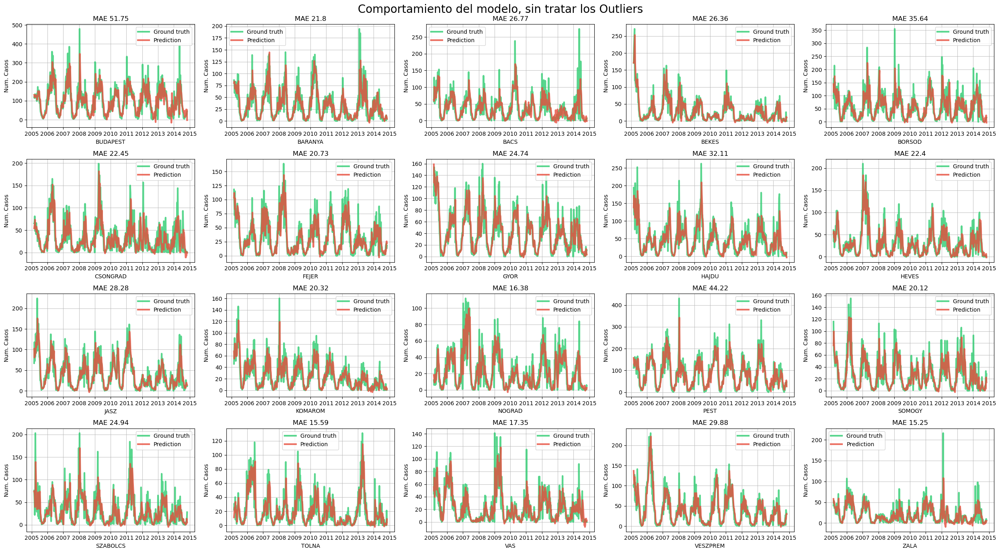

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= data_orig.iloc[:, i]
        media=df_data.mean()
        std=df_data.std()
        outlier_value=media+(3*std)
        model_dummy=time_series.HoltWinters(alpha=0.6,beta=0.04,gamma=0.9)
        label=data_orig.columns[i]
        model_s = ( get_ordinal_date|  time_series.SNARIMAX(
                p=4,
                d=0,
                q=9,
                m=52,
                sp=4,
                sq=9,
                regressor=(
                    preprocessing.StandardScaler() | 
                    linear_model.LinearRegression(
                        intercept_init=110,
                        optimizer=optim.SGD(0.001),
                        intercept_lr=0.3
                    )
                )
            )
        )
        evaluate_forecasting(model_s,df_data,ax,label,horizonte=8,outlier_value=0)
  
        i += 1
fig.suptitle("Comportamiento del modelo, sin tratar los Outliers", fontsize=20)
plt.tight_layout()
plt.show()

##### 2.2.2.2.2 Gráfica y Comportamiento de la predicción a 2 meses (8 semanas). Tratando los outliers.

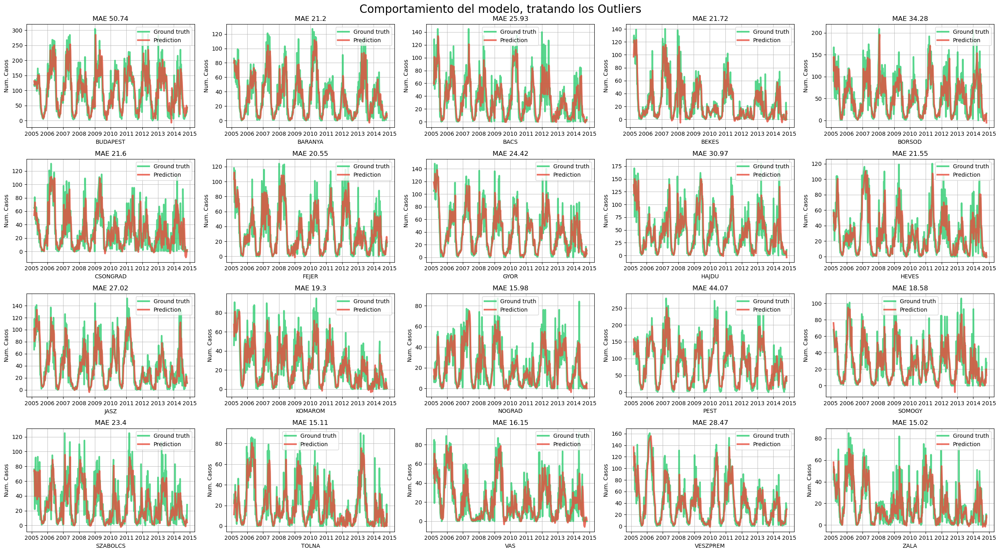

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= data_orig.iloc[:, i]
        media=df_data.mean()
        std=df_data.std()
        outlier_value=media+(3*std)
        model_dummy=time_series.HoltWinters(alpha=0.6,beta=0.04,gamma=0.9)
        label=data_orig.columns[i]
        model_s = ( get_ordinal_date|  time_series.SNARIMAX(
                p=4,
                d=0,
                q=9,
                m=52,
                sp=4,
                sq=9,
                regressor=(
                    preprocessing.StandardScaler() | 
                    linear_model.LinearRegression(
                        intercept_init=110,
                        optimizer=optim.SGD(0.001),
                        intercept_lr=0.3
                    )
                )
            )
        )
        evaluate_forecasting(model_s,df_data,ax,label,horizonte=8,outlier_value=outlier_value)
       
        i += 1
fig.suptitle("Comportamiento del modelo, tratando los Outliers", fontsize=20)
plt.tight_layout()
plt.show()

#### 2.2.2.3 Gráficas y comportamiento del modelo SNARIMAX con horizonte a 3 meses (12 semanas).

##### 2.2.2.3.1 Gráfica y Comportamiento de la predicción a 3 meses (12 semanas). Sin tratar los outliers.



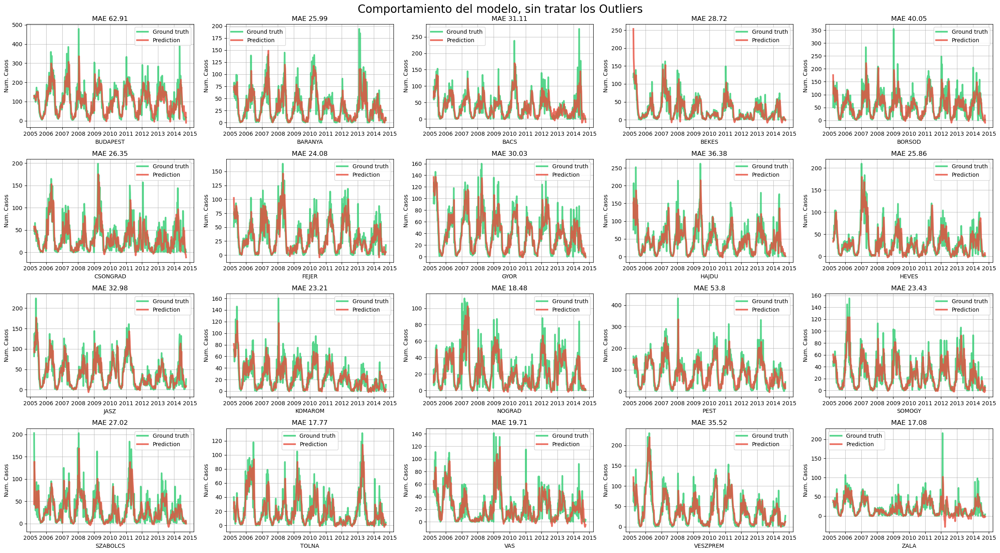

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= data_orig.iloc[:, i]
        media=df_data.mean()
        std=df_data.std()
        outlier_value=media+(3*std)
        model_dummy=time_series.HoltWinters(alpha=0.6,beta=0.04,gamma=0.9)
        label=data_orig.columns[i]
        model_s = ( get_ordinal_date|  time_series.SNARIMAX(
                p=4,
                d=0,
                q=9,
                m=52,
                sp=4,
                sq=9,
                regressor=(
                    preprocessing.StandardScaler() | 
                    linear_model.LinearRegression(
                        intercept_init=110,
                        optimizer=optim.SGD(0.001),
                        intercept_lr=0.3
                    )
                )
            )
        )
        evaluate_forecasting(model_s,df_data,ax,label,horizonte=12,outlier_value=0)
  
        i += 1
fig.suptitle("Comportamiento del modelo, sin tratar los Outliers", fontsize=20)
plt.tight_layout()
plt.show()

##### 2.2.2.3.2 Gráfica y Comportamiento de la predicción a 3 meses (12 semanas). Tratando los outliers.

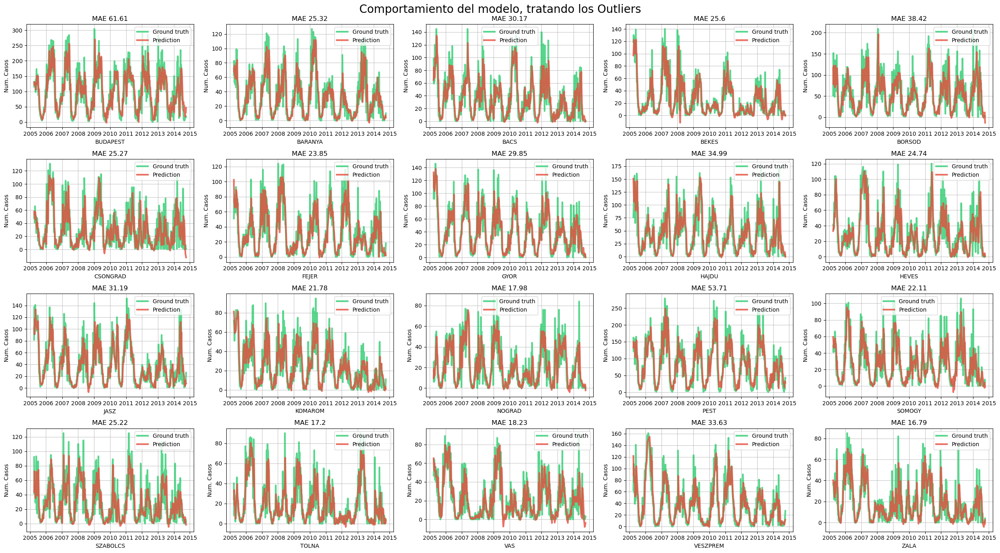

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= data_orig.iloc[:, i]
        media=df_data.mean()
        std=df_data.std()
        outlier_value=media+(3*std)
        model_dummy=time_series.HoltWinters(alpha=0.6,beta=0.04,gamma=0.9)
        label=data_orig.columns[i]
        model_s = ( get_ordinal_date|  time_series.SNARIMAX(
                p=4,
                d=0,
                q=9,
                m=52,
                sp=4,
                sq=9,
                regressor=(
                    preprocessing.StandardScaler() | 
                    linear_model.LinearRegression(
                        intercept_init=110,
                        optimizer=optim.SGD(0.001),
                        intercept_lr=0.3
                    )
                )
            )
        )
        evaluate_forecasting(model_s,df_data,ax,label,horizonte=12,outlier_value=outlier_value)
       
        i += 1
fig.suptitle("Comportamiento del modelo, tratando los Outliers", fontsize=20)
plt.tight_layout()
plt.show()

#### 2.2.2.4 Gráficas y comportamiento del modelo HoltWinter (Base Line) con horizonte a 1 mes.

##### 2.2.2.4.1 Gráfica y Comportamiento de la prediccion a 1 mes (4 semánas). Sin tratar los outliers.

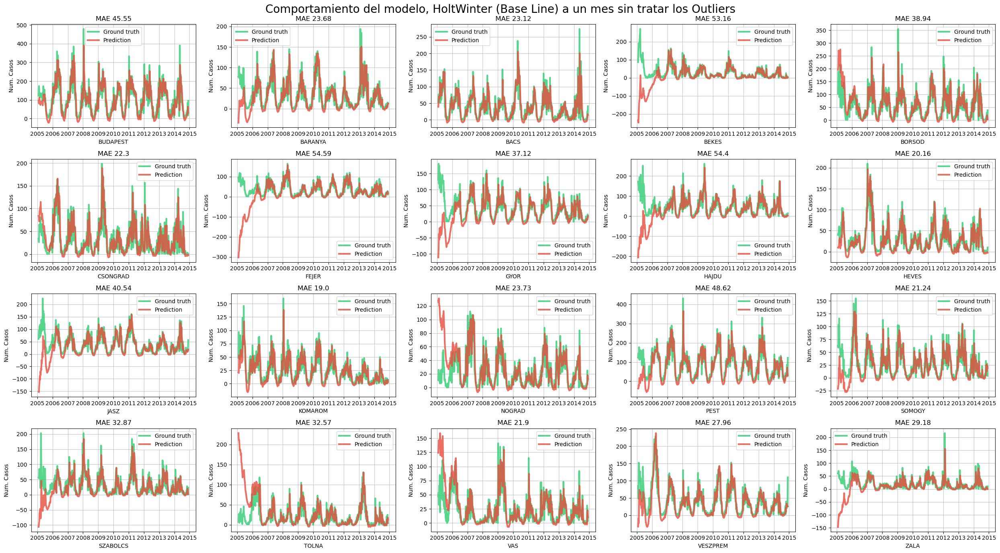

In [ ]:

fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= data_orig.iloc[:, i]
        media=df_data.mean()
        std=df_data.std()
        outlier_value=media+(3*std)
        model_dummy=time_series.HoltWinters(alpha=0.6,beta=0.04,gamma=0.9)
        label=data_orig.columns[i]
        model_s = ( get_ordinal_date|  time_series.SNARIMAX(
                p=4,
                d=0,
                q=9,
                m=52,
                sp=4,
                sq=9,
                regressor=(
                    preprocessing.StandardScaler() | 
                    linear_model.LinearRegression(
                        intercept_init=110,
                        optimizer=optim.SGD(0.001),
                        intercept_lr=0.3
                    )
                )
            )
        )
        evaluate_forecasting(model_dummy,df_data,ax,label,horizonte=4,outlier_value=0,model='baseline')
  
        i += 1
fig.suptitle("Comportamiento del modelo, HoltWinter (Base Line) a un mes sin tratar los Outliers", fontsize=20)
plt.tight_layout()
plt.show()

##### 2.2.2.1.2 Gráfica y Comportamiento de la prediccion a 1 mes (4 semánas). Tratando los outliers.

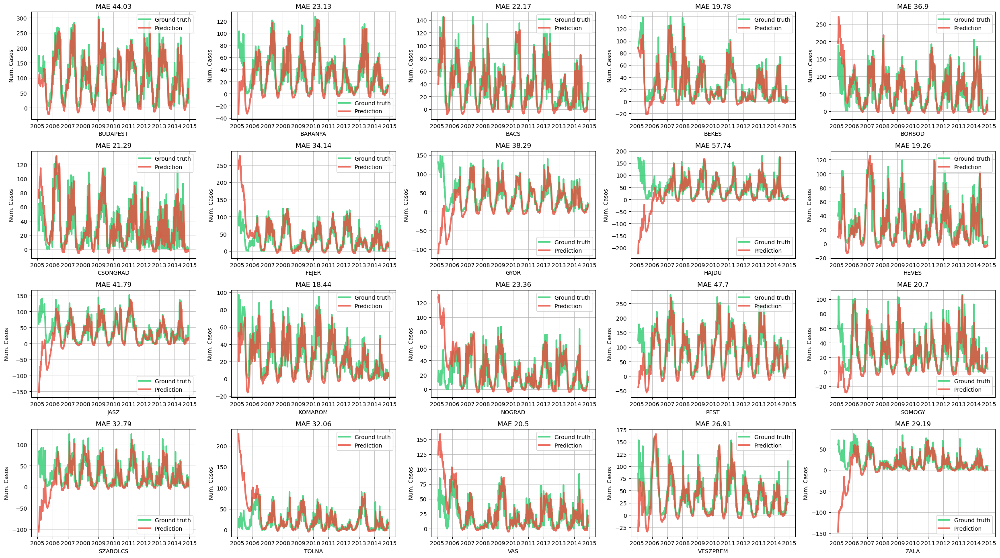

In [ ]:
_baselinefig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= data_orig.iloc[:, i]
        media=df_data.mean()
        std=df_data.std()
        outlier_value=media+(3*std)
        model_dummy=time_series.HoltWinters(alpha=0.6,beta=0.04,gamma=0.9)
        label=data_orig.columns[i]
        model_s = ( get_ordinal_date|  time_series.SNARIMAX(
                p=4,
                d=0,
                q=9,
                m=52,
                sp=4,
                sq=9,
                regressor=(
                    preprocessing.StandardScaler() | 
                    linear_model.LinearRegression(
                        intercept_init=110,
                        optimizer=optim.SGD(0.001),
                        intercept_lr=0.3
                    )
                )
            )
        )
        evaluate_forecasting(model_dummy,df_data,ax,label,horizonte=4,outlier_value=outlier_value,model='baseline')
        #evaluate_model(model_hft_reg.clone(),df_data,label,ax,etiqueta="hft",check_drift=False,check_outliers=False,is_data_drifted=False)
        i += 1
fig.suptitle("Comportamiento del modelo, HoltWinter (Base Line) a un mes tratando los Outliers", fontsize=20)
plt.tight_layout()
plt.show()

#### 2.2.2.5 Gráficas y comportamiento del modelo HoltWinter (Base Line) con horizonte a 2 meses (8 semanas).

##### 2.2.2.5.1 Gráfica y Comportamiento de la prediccion a 2 meses (8 semanas). Sin tratar los outliers.

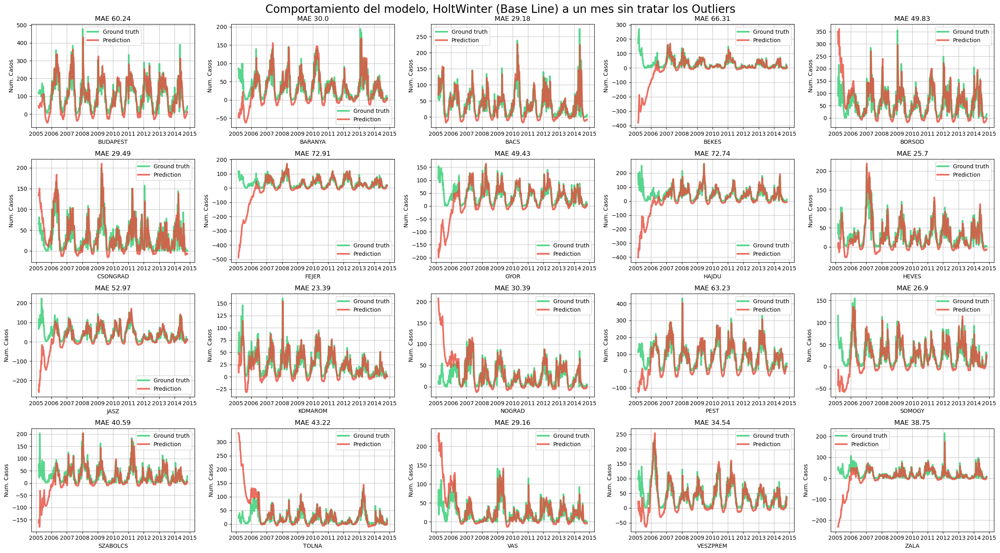

In [ ]:

fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= data_orig.iloc[:, i]
        media=df_data.mean()
        std=df_data.std()
        outlier_value=media+(3*std)
        model_dummy=time_series.HoltWinters(alpha=0.6,beta=0.04,gamma=0.9)
        label=data_orig.columns[i]
        model_s = ( get_ordinal_date|  time_series.SNARIMAX(
                p=4,
                d=0,
                q=9,
                m=52,
                sp=4,
                sq=9,
                regressor=(
                    preprocessing.StandardScaler() | 
                    linear_model.LinearRegression(
                        intercept_init=110,
                        optimizer=optim.SGD(0.001),
                        intercept_lr=0.3
                    )
                )
            )
        )
        evaluate_forecasting(model_dummy,df_data,ax,label,horizonte=8,outlier_value=0,model='baseline')
  
        i += 1
fig.suptitle("Comportamiento del modelo, HoltWinter (Base Line) a un mes sin tratar los Outliers", fontsize=20)
plt.tight_layout()
plt.show()

##### 2.2.2.5.2 Gráfica y Comportamiento de la prediccion a 2 meses (8 semanas). Tratando los outliers.

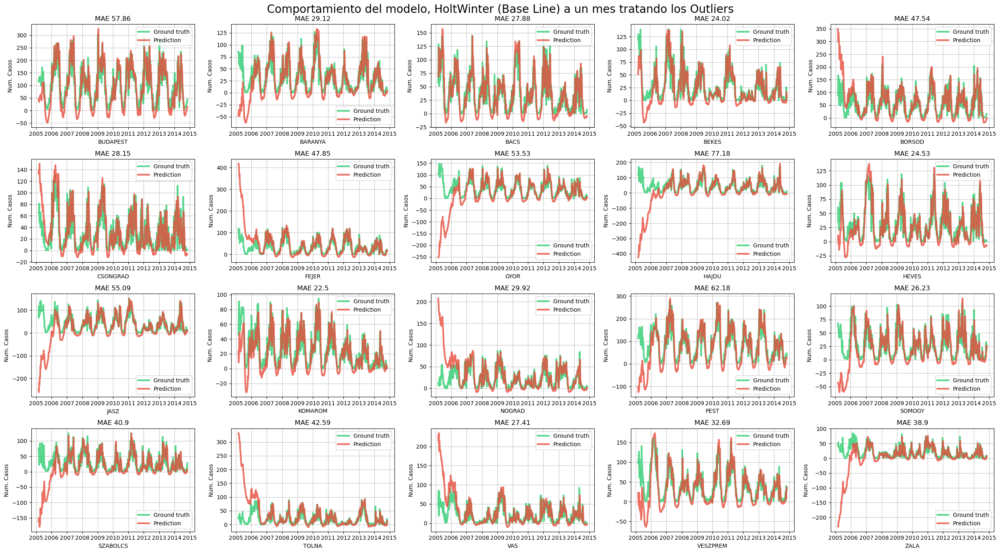

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= data_orig.iloc[:, i]
        media=df_data.mean()
        std=df_data.std()
        outlier_value=media+(3*std)
        model_dummy=time_series.HoltWinters(alpha=0.6,beta=0.04,gamma=0.9)
        label=data_orig.columns[i]
        model_s = ( get_ordinal_date|  time_series.SNARIMAX(
                p=4,
                d=0,
                q=9,
                m=52,
                sp=4,
                sq=9,
                regressor=(
                    preprocessing.StandardScaler() | 
                    linear_model.LinearRegression(
                        intercept_init=110,
                        optimizer=optim.SGD(0.001),
                        intercept_lr=0.3
                    )
                )
            )
        )
        evaluate_forecasting(model_dummy,df_data,ax,label,horizonte=8,outlier_value=outlier_value,model='baseline')
        #evaluate_model(model_hft_reg.clone(),df_data,label,ax,etiqueta="hft",check_drift=False,check_outliers=False,is_data_drifted=False)
        i += 1
fig.suptitle("Comportamiento del modelo, HoltWinter (Base Line) a un mes tratando los Outliers", fontsize=20)
plt.tight_layout()
plt.show()

#### 2.2.2.6 Gráficas y comportamiento del modelo HoltWinter (Base Line) con horizonte a 3 meses (12 semanas ).

##### 2.2.2.6.1 Gráfica y Comportamiento de la prediccion a 3 meses (12 semanas). Sin tratar los outliers.

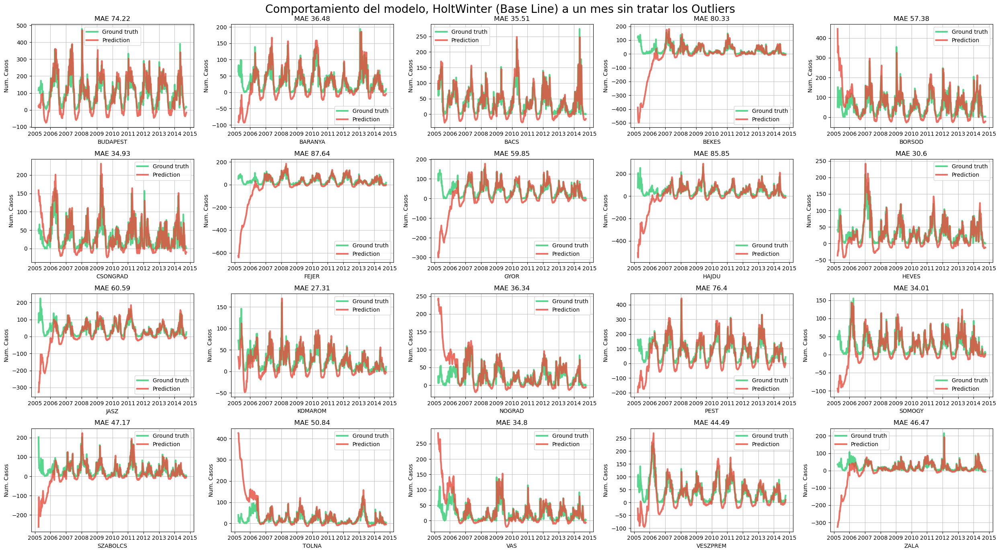

In [ ]:

fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= data_orig.iloc[:, i]
        media=df_data.mean()
        std=df_data.std()
        outlier_value=media+(3*std)
        model_dummy=time_series.HoltWinters(alpha=0.6,beta=0.04,gamma=0.9)
        label=data_orig.columns[i]
        model_s = ( get_ordinal_date|  time_series.SNARIMAX(
                p=4,
                d=0,
                q=9,
                m=52,
                sp=4,
                sq=9,
                regressor=(
                    preprocessing.StandardScaler() | 
                    linear_model.LinearRegression(
                        intercept_init=110,
                        optimizer=optim.SGD(0.001),
                        intercept_lr=0.3
                    )
                )
            )
        )
        evaluate_forecasting(model_dummy,df_data,ax,label,horizonte=12,outlier_value=0,model='baseline')
  
        i += 1
fig.suptitle("Comportamiento del modelo, HoltWinter (Base Line) a un mes sin tratar los Outliers", fontsize=20)
plt.tight_layout()
plt.show()

##### 2.2.2.6.2 Gráfica y Comportamiento de la prediccion a 3 meses (12 semanas). Tratando los outliers.

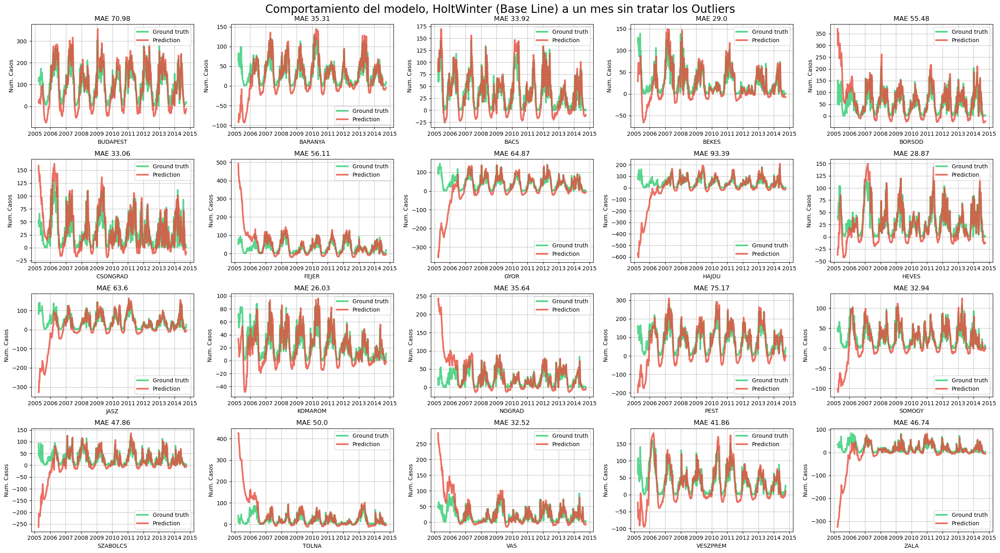

In [ ]:

fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= data_orig.iloc[:, i]
        media=df_data.mean()
        std=df_data.std()
        outlier_value=media+(3*std)
        model_dummy=time_series.HoltWinters(alpha=0.6,beta=0.04,gamma=0.9)
        label=data_orig.columns[i]
        model_s = ( get_ordinal_date|  time_series.SNARIMAX(
                p=4,
                d=0,
                q=9,
                m=52,
                sp=4,
                sq=9,
                regressor=(
                    preprocessing.StandardScaler() | 
                    linear_model.LinearRegression(
                        intercept_init=110,
                        optimizer=optim.SGD(0.001),
                        intercept_lr=0.3
                    )
                )
            )
        )
        evaluate_forecasting(model_dummy,df_data,ax,label,horizonte=12,outlier_value=outlier_value,model='baseline')
  
        i += 1
fig.suptitle("Comportamiento del modelo, HoltWinter (Base Line) a un mes sin tratar los Outliers", fontsize=20)
plt.tight_layout()
plt.show()

### 2.2.3 Gráficas, comparación de la métrica de error seleccionada (MAE)de los distintos horizontes con el Modelo SNARIMAX y Baseline.
Se compara la evolución del error, MAE, de cada uno de los modelos para cada ciudad.En este apartado se puede comprobar que la comparación de los distintos horizontes del modelo SNARIMAX vs distintos horizontes Baseline, en el modelo SNARIMAX se consigue un menor error MAE, tanto en la versión del tratamiento de los outliers como sin tratarlos. También se adivina que a menor horizonte, mayor precisión en las predicciones.

#### 2.2.3.1 Gráficas de error  y comportamiento del modelo SNARIMAX con varios horizontes, para cada ciudad sin tratar los outliers.

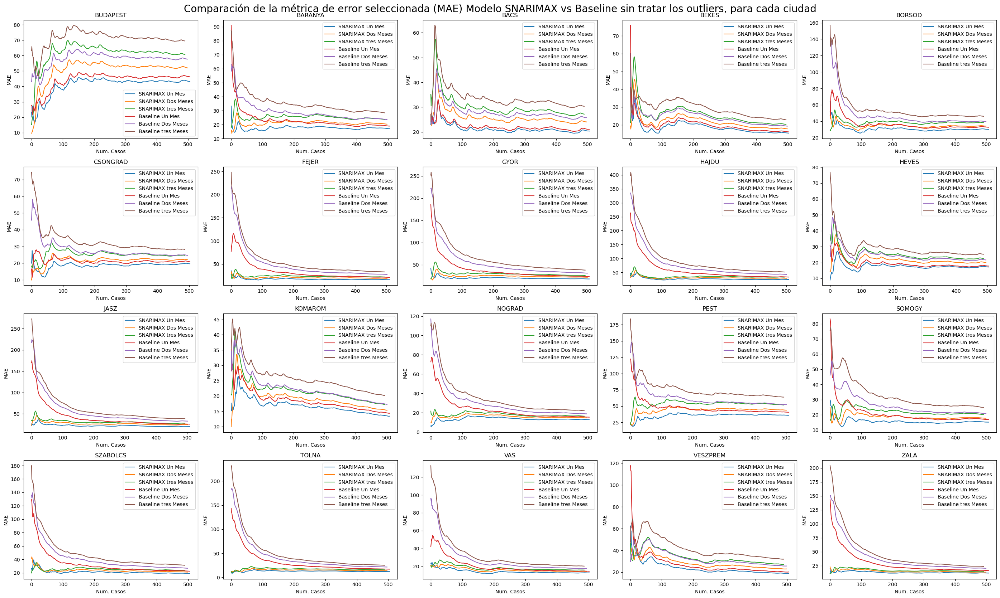

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(28, 17))
i = 0
for row in axes:
    for ax in row:
        label=data_orig.columns[i]
        ax.set_title(label)
        df_error_mae_un_mes[label].plot(ax=ax)
        df_error_mae_dos_meses[label].plot(ax=ax)
        df_error_mae_tres_meses[label].plot(ax=ax)
        df_error_mae_un_mes_baseline[label].plot(ax=ax)
        df_error_mae_dos_meses_baseline[label].plot(ax=ax)
        df_error_mae_tres_meses_baseline[label].plot(ax=ax)
        ax.set_xlabel(label_num_casos)
        ax.set_ylabel("MAE")
        ax.legend(["SNARIMAX Un Mes", "SNARIMAX Dos Meses","SNARIMAX tres Meses","Baseline Un Mes", "Baseline Dos Meses","Baseline tres Meses"]);
        i += 1
fig.suptitle("Comparación de la métrica de error seleccionada (MAE) Modelo SNARIMAX vs Baseline sin tratar los outliers, para cada ciudad", fontsize=20)
plt.tight_layout()
plt.show()

#### 2.2.3.2 Gráficas de error  y comportamiento del modelo HoltWinters (Baseline) con varios horizontes , para cada ciudad tratando los outliers.

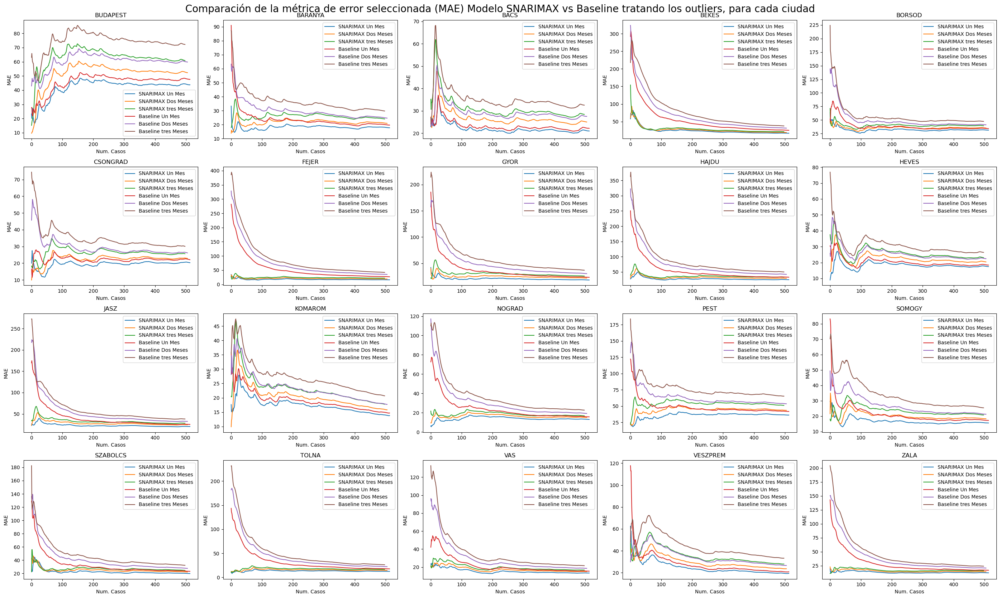

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(28, 17))
i = 0
for row in axes:
    for ax in row:
        label=data_orig.columns[i]
        ax.set_title(label)
        df_error_mae_un_mes_sin_outliers[label].plot(ax=ax)
        df_error_mae_dos_meses_sin_outliers[label].plot(ax=ax)
        df_error_mae_tres_meses_sin_outliers[label].plot(ax=ax)
        df_error_mae_un_mes_sin_outliers_baseline[label].plot(ax=ax)
        df_error_mae_dos_meses_sin_outliers_baseline[label].plot(ax=ax)
        df_error_mae_tres_meses_sin_outliers_baseline[label].plot(ax=ax)
        ax.set_xlabel(label_num_casos)
        ax.set_ylabel("MAE")
        ax.legend(["SNARIMAX Un Mes", "SNARIMAX Dos Meses","SNARIMAX tres Meses","Baseline Un Mes", "Baseline Dos Meses","Baseline tres Meses"]);
        i += 1
fig.suptitle("Comparación de la métrica de error seleccionada (MAE) Modelo SNARIMAX vs Baseline tratando los outliers, para cada ciudad", fontsize=20)
plt.tight_layout()
plt.show()

### 2.2.4  Graficas de cada modelo **para cada ciudad** comparando la evolución del error tratando los outliers vs sin tratarlos.
Se puede ver que as predicciones a mas corto plazo presentan menos error y que a su vez, el tratamiento de los outliers, nos conduce a unas predicciones mas precisas, menos error.

#### 2.2.4.1 Modelo SNARIMAX con los distintos horizontes (1,2 y 3 meses) tratando outliers y sin tratar.

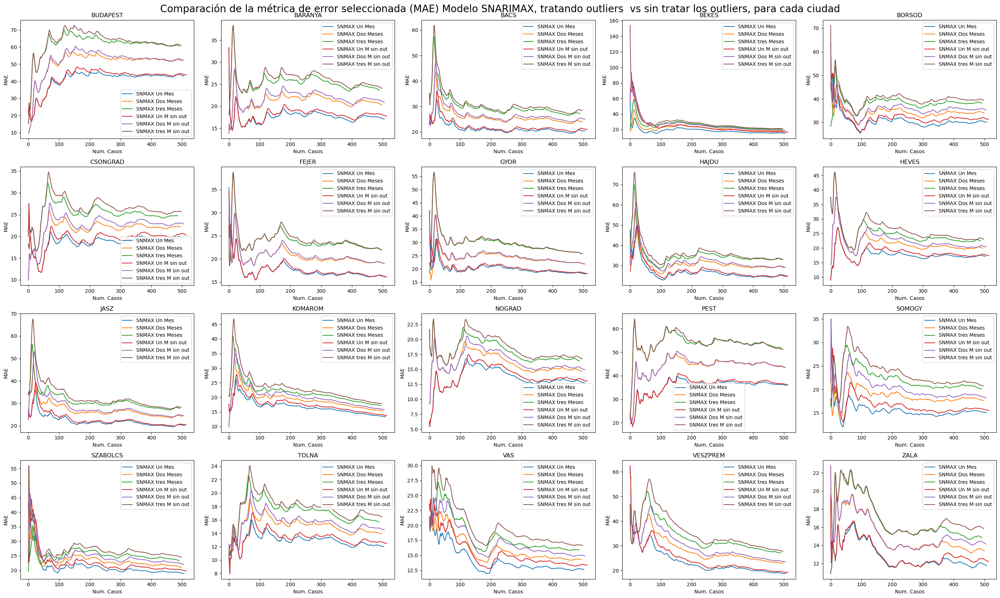

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(28, 17))
i = 0
for row in axes:
    for ax in row:
        label=data_orig.columns[i]
        ax.set_title(label)
        df_error_mae_un_mes[label].plot(ax=ax)
        df_error_mae_dos_meses[label].plot(ax=ax)
        df_error_mae_tres_meses[label].plot(ax=ax)
        df_error_mae_un_mes_sin_outliers[label].plot(ax=ax)
        df_error_mae_dos_meses_sin_outliers[label].plot(ax=ax)
        df_error_mae_tres_meses_sin_outliers[label].plot(ax=ax)
        ax.set_xlabel(label_num_casos)
        ax.set_ylabel("MAE")
        ax.legend(["SNMAX Un Mes", "SNMAX Dos Meses","SNMAX tres Meses","SNMAX Un M sin out", "SNMAX Dos M sin out","SNMAX tres M sin out"]);
        i += 1
fig.suptitle("Comparación de la métrica de error seleccionada (MAE) Modelo SNARIMAX, tratando outliers  vs sin tratar los outliers, para cada ciudad", fontsize=20)
plt.tight_layout()
plt.show()

#### 2.2.4.2 Modelo Baseline con los distintos horizontes (1,2 y 3 meses) tratando outliers y sin tratar.

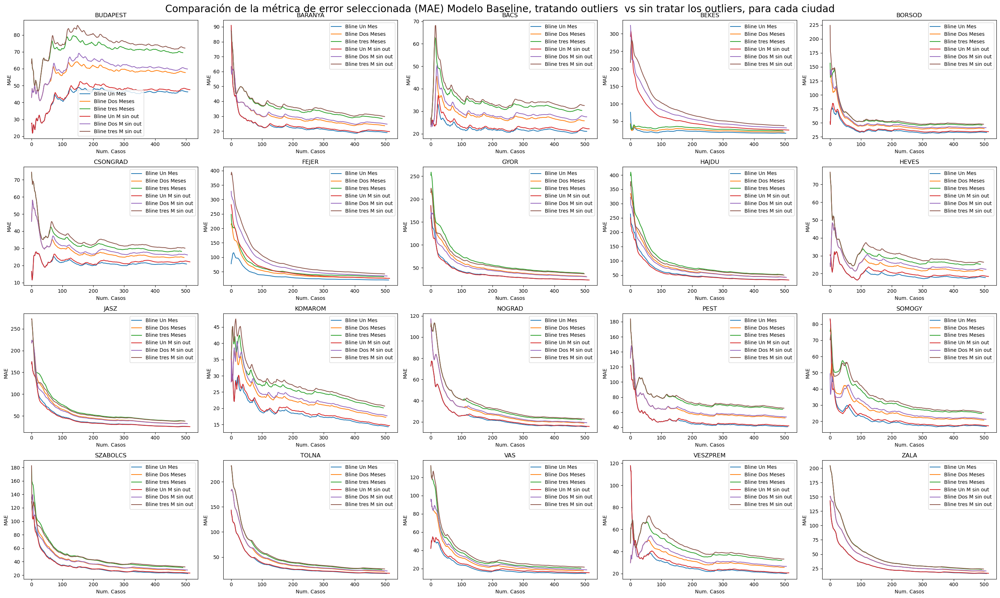

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(28, 17))
i = 0
for row in axes:
    for ax in row:
        label=data_orig.columns[i]
        ax.set_title(label)
        df_error_mae_un_mes_baseline[label].plot(ax=ax)
        df_error_mae_dos_meses_baseline[label].plot(ax=ax)
        df_error_mae_tres_meses_baseline[label].plot(ax=ax)
        df_error_mae_un_mes_sin_outliers_baseline[label].plot(ax=ax)
        df_error_mae_dos_meses_sin_outliers_baseline[label].plot(ax=ax)
        df_error_mae_tres_meses_sin_outliers_baseline[label].plot(ax=ax)
        ax.set_xlabel(label_num_casos)
        ax.set_ylabel("MAE")
        ax.legend(["Bline Un Mes", "Bline Dos Meses","Bline tres Meses","Bline Un M sin out", "Bline Dos M sin out","Bline tres M sin out"]);
        i += 1
fig.suptitle("Comparación de la métrica de error seleccionada (MAE) Modelo Baseline, tratando outliers  vs sin tratar los outliers, para cada ciudad", fontsize=20)
plt.tight_layout()
plt.show()

### 2.2.5 Aqui vamos a introducir un Concept Drift artificial para ver como se comportan las predicciones a largo plazo

In [ ]:
df_data_orig_drifted=data_orig.copy()
for column in df_data_orig_drifted.columns:
   for index, value in df_data_orig_drifted[column].items(): 
    if (index >=pd.Timestamp('2008-01-01') and index <=pd.Timestamp('2011-12-30') ):
        df_data_orig_drifted[column].at[index]= value *0.3

In [ ]:
#Método que entrena el modelo y crea las métricas

#Dataframes para recoger los errores y mostrarlos en las gráficas sin tener en cuenta los outliers
df_error_mae_un_mes_sin_concept=pd.DataFrame(columns=data_orig.columns)
df_error_mae_dos_meses_sin_concept=pd.DataFrame(columns=data_orig.columns)
df_error_mae_tres_meses_sin_concept=pd.DataFrame(columns=data_orig.columns)


#Dataframes para recoger los errores y mostrarlos en las gráficas tratando concept drift
df_error_mae_un_mes_con_concept=pd.DataFrame(columns=data_orig.columns)
df_error_mae_dos_meses_con_concept=pd.DataFrame(columns=data_orig.columns)
df_error_mae_tres_meses_con_concept=pd.DataFrame(columns=data_orig.columns)


#Dataframes para recoger los errores base line y mostrarlos en las gráficas sin tener en cuenta los outliers
df_error_mae_un_mes_baseline_sin_concept=pd.DataFrame(columns=data_orig.columns)
df_error_mae_dos_meses_baseline_sin_concept=pd.DataFrame(columns=data_orig.columns)
df_error_mae_tres_meses_baseline_sin_concept=pd.DataFrame(columns=data_orig.columns)


#Dataframes para recoger los errores base line y mostrarlos en las gráficas considerando los outliers
df_error_mae_un_mes_baseline_con_concept=pd.DataFrame(columns=data_orig.columns)
df_error_mae_dos_meses_baseline_con_concept=pd.DataFrame(columns=data_orig.columns)
df_error_mae_tres_meses_baseline_con_concept=pd.DataFrame(columns=data_orig.columns)

#Redefinimos el metodo iter_evaluate, para poder sacar las métricas y crear la tabla de resultados y las gráficas, solo para tratar drift o no
def evaluate_forecasting_with_drift(modelo,data,ax,column,horizonte,outlier_value=0, model ='snarimax',check_drift=False):
    """Evaluates the performance of a forecaster on a time series dataset and yields results, through iter_evaluate_with_drift method
    and gathers metrics and plots the results predictions vs ground truth.
    This method is only intended for outliers. Handling outliers or not depending on the vlue of outlier_value
          
    Parameters
    ----------
    @dataset
        A sequential time series.
    @model
        A forecaster.
   
    @horizon horizon to forecast
    @outlier value
        if >0 it means handling the outliers
    @ax: axis where to plot predictions vs ground truth.
    @column: which data column is handled (Hungarian county)
    @model:label to handle error messages accordingly
    @check_drift: If drift has to be checked or not
    """
  
    metricas = iter_evaluate_with_drift(
        dataset=data.T.iteritems(),
        model=modelo,
        metric=metrics.MAE(),
        horizon=horizonte,
        agg_func=statistics.mean,
        outlier_value=outlier_value,
        check_drift=check_drift,
        model_to_check=model
        )
    dates = []
    y_trues = []
    y_preds = []
    lista=[]
    lista_drifts=[]
    horizon=horizonte
    std=round(data.std(),2)
    mean=round(data.mean(),2)
    i=0
    if check_drift:
      mensaje ="3 MAE Datos con drift en datos y tratando el drift con horizonte= "
      mensaje_drifts ="5 Num Drifts Datos con drift en datos y tratando el drift con horizonte= "
    else:
      mensaje ="4 MAE Datos con drift en datos y sin tratar el drift con horizonte= "
      
    for m in metricas:
          
          dates.append(m[0])
          y_trues.append(m[1])
          y_preds.append(m[2][horizon-1])
          lista.append(m[3].get())
          lista_drifts=m[4]
          if model=='snarimax':
            if check_drift:
              if horizonte==4:
                df_error_mae_un_mes_con_concept.at[i,column] =round(m[3].get(),2)
              elif horizonte==8:
                df_error_mae_dos_meses_con_concept.at[i,column] =round(m[3].get(),2)
              elif horizonte==12:
                df_error_mae_tres_meses_con_concept.at[i,column] =round(m[3].get(),2)
            else:
              if horizonte==4:
                df_error_mae_un_mes_sin_concept.at[i,column] =round(m[3].get(),2)
              elif horizonte==8:
                df_error_mae_dos_meses_sin_concept.at[i,column] =round(m[3].get(),2)
              elif horizonte==12:
                df_error_mae_tres_meses_sin_concept.at[i,column] =round(m[3].get(),2)
          else: #model= baseline
            if  check_drift:
              if horizonte==4:
                df_error_mae_un_mes_baseline_con_concept.at[i,column] =round(m[3].get(),2)
              elif horizonte==8:
                df_error_mae_dos_meses_baseline_con_concept.at[i,column] =round(m[3].get(),2)
              elif horizonte==12:
                df_error_mae_tres_meses_baseline_con_concept.at[i,column] =round(m[3].get(),2)
            else:
              if horizonte==4:
                df_error_mae_un_mes_baseline_sin_concept.at[i,column] =round(m[3].get(),2)
              elif horizonte==8:
                df_error_mae_dos_meses_baseline_sin_concept.at[i,column] =round(m[3].get(),2)
              elif horizonte==12:
                df_error_mae_tres_meses_baseline_sin_concept.at[i,column] =round(m[3].get(),2)

          i+=1
    
    metric=round(sum(lista)/len(lista),2)#average of MAES
    # Plot the results
    ax=ax
    for drift in lista_drifts:
              ax.axvline(drift, color='red')
    ax.grid(alpha=0.75)
    ax.plot(dates, y_trues, lw=3, color='#2ecc71', alpha=0.8, label='Ground truth')
    ax.plot(dates, y_preds, lw=3, color='#e74c3c', alpha=0.8, label='Prediction')
    ax.legend()
    ax.set_title("MAE "+str(metric))
    ax.set_xlabel(column)
    ax.set_ylabel(label_num_casos)
    df_datos_largo_plazo.at['STD', column] = std
    df_datos_largo_plazo.at['MEAN', column] = mean
    df_datos_largo_plazo.at[mensaje+ ' '+str(horizonte)+' semanas' +' modelo: '+model, column] = metric
    if check_drift:
      df_datos_largo_plazo.at[mensaje_drifts+' '+str(horizonte)+' semanas' +' modelo ='+model, column] = len(lista_drifts)

  


#### 2.2.5.1 Gráficas y comportamiento del modelo SNARIMAX con horizonte a 1 meses (4 semanas). 
En este apartado vamos a ver igual que ocurria con el Nowcasting que si se trata el Concept Drift cuando este aparece, el modelo se comporta mejor en cuanto a la métrica seleccionada.

##### 2.2.5.1.1 Gráfica y comportamiento de la predicción a 1 mes (4 semenas). Sin tratar el Concept Drift.

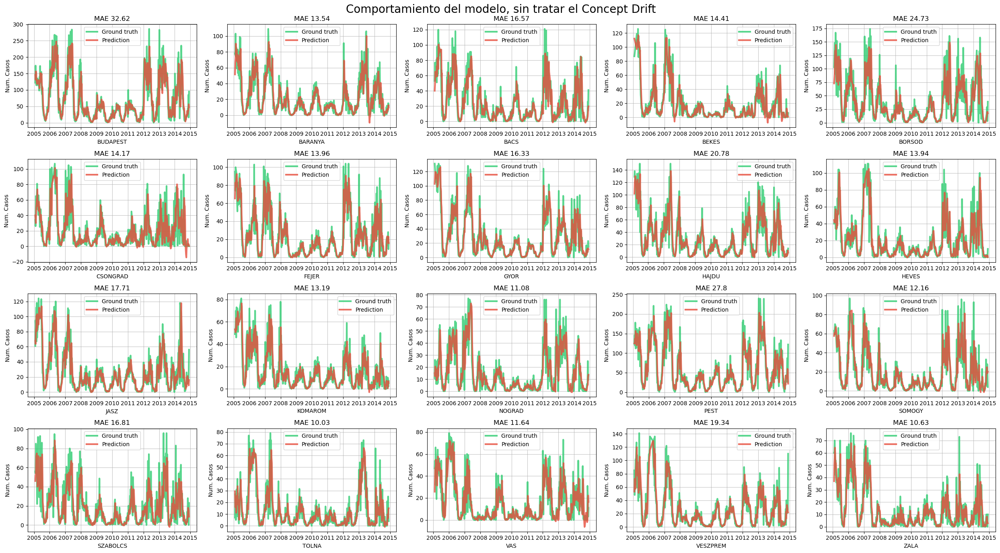

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= df_data_orig_drifted.iloc[:, i]
        media=df_data.mean()
        std=df_data.std()
        outlier_value=media+(3*std)
        model_dummy=time_series.HoltWinters(alpha=0.6,beta=0.04,gamma=0.9)
        label=data_orig.columns[i]
        
        model_s = ( get_ordinal_date|  time_series.SNARIMAX(
                p=4,
                d=0,
                q=9,
                m=52,
                sp=4,
                sq=9,
                regressor=(
                    preprocessing.StandardScaler() | 
                    linear_model.LinearRegression(
                        intercept_init=110,
                        optimizer=optim.SGD(0.001),
                        intercept_lr=0.3
                    )
                )
            )
        )
        evaluate_forecasting_with_drift(model_s,df_data,ax,label,horizonte=4,outlier_value=outlier_value,model="snarimax",check_drift=False)
        i += 1
fig.suptitle("Comportamiento del modelo, sin tratar el Concept Drift", fontsize=20)
plt.tight_layout()
plt.show()

##### 2.2.5.1.2 Gráfica y comportamiento de la predicción a 1 mes (4 semenas).Tratando el Concept Drift.

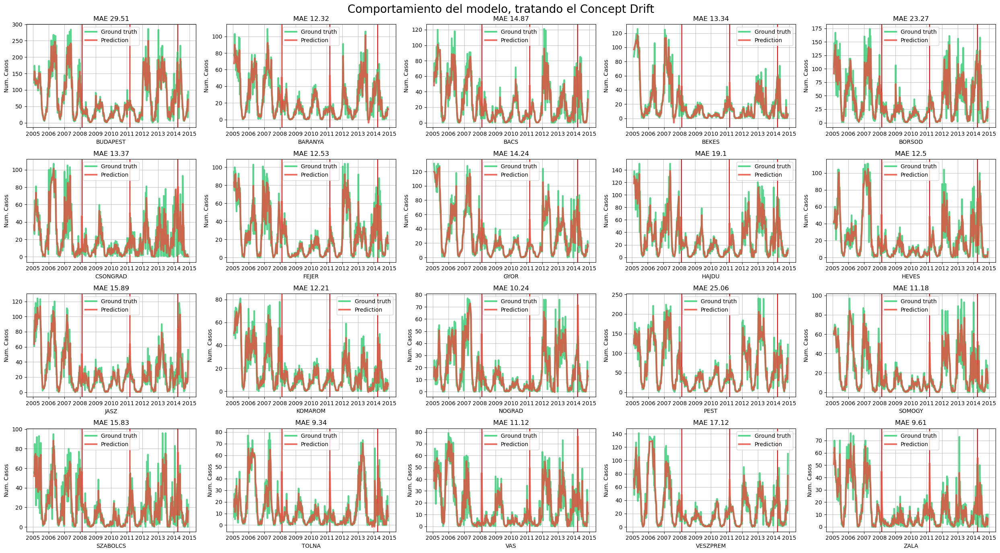

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= df_data_orig_drifted.iloc[:, i]
        media=df_data.mean()
        std=df_data.std()
        outlier_value=media+(3*std)
        model_dummy=time_series.HoltWinters(alpha=0.6,beta=0.04,gamma=0.9)
        label=data_orig.columns[i]
        
        model_s = ( get_ordinal_date|  time_series.SNARIMAX(
                p=4,
                d=0,
                q=9,
                m=52,
                sp=4,
                sq=9,
                regressor=(
                    preprocessing.StandardScaler() | 
                    linear_model.LinearRegression(
                        intercept_init=110,
                        optimizer=optim.SGD(0.001),
                        intercept_lr=0.3
                    )
                )
            )
        )
        evaluate_forecasting_with_drift(model_s,df_data,ax,label,horizonte=4,outlier_value=outlier_value,model="snarimax",check_drift=True)
        i += 1
fig.suptitle("Comportamiento del modelo, tratando el Concept Drift", fontsize=20)
plt.tight_layout()
plt.show()

#### 2.2.5.2 Gráficas y comportamiento del modelo SNARIMAX con horizonte a 2 meses (8 semanas).

##### 2.2.5.2.1 Gráfica y comportamiento de la predicción a 2 meses (8 semenas). Sin tratar el Concept Drift.

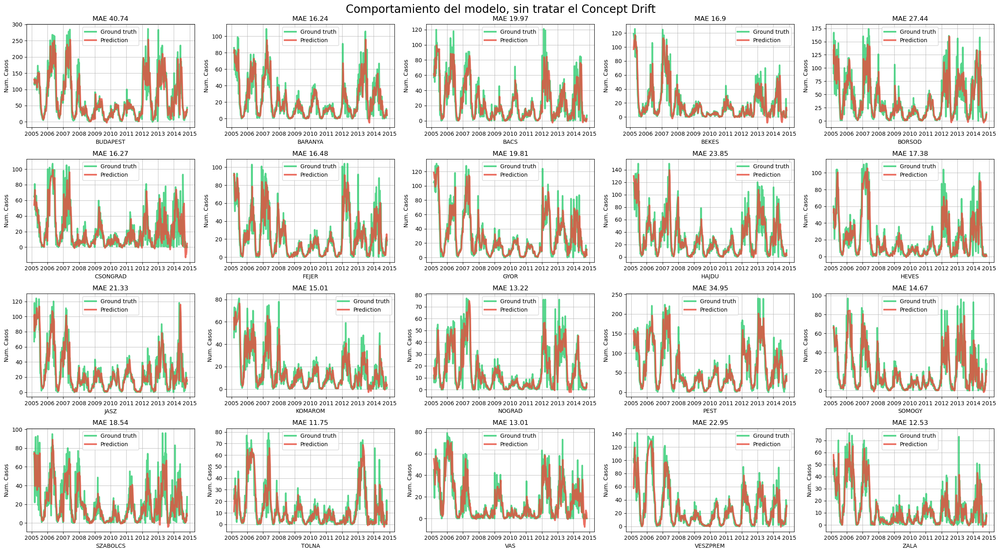

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= df_data_orig_drifted.iloc[:, i]
        media=df_data.mean()
        std=df_data.std()
        outlier_value=media+(3*std)
        model_dummy=time_series.HoltWinters(alpha=0.6,beta=0.04,gamma=0.9)
        label=data_orig.columns[i]
        
        model_s = ( get_ordinal_date|  time_series.SNARIMAX(
                p=4,
                d=0,
                q=9,
                m=52,
                sp=4,
                sq=9,
                regressor=(
                    preprocessing.StandardScaler() | 
                    linear_model.LinearRegression(
                        intercept_init=110,
                        optimizer=optim.SGD(0.001),
                        intercept_lr=0.3
                    )
                )
            )
        )
        evaluate_forecasting_with_drift(model_s,df_data,ax,label,horizonte=8,outlier_value=outlier_value,model="snarimax",check_drift=False)
        i += 1
fig.suptitle("Comportamiento del modelo, sin tratar el Concept Drift", fontsize=20)
plt.tight_layout()
plt.show()

##### 2.2.5.1.2 Gráfica y comportamiento de la predicción a 2 meses (8 semenas).Tratando el Concept Drift.

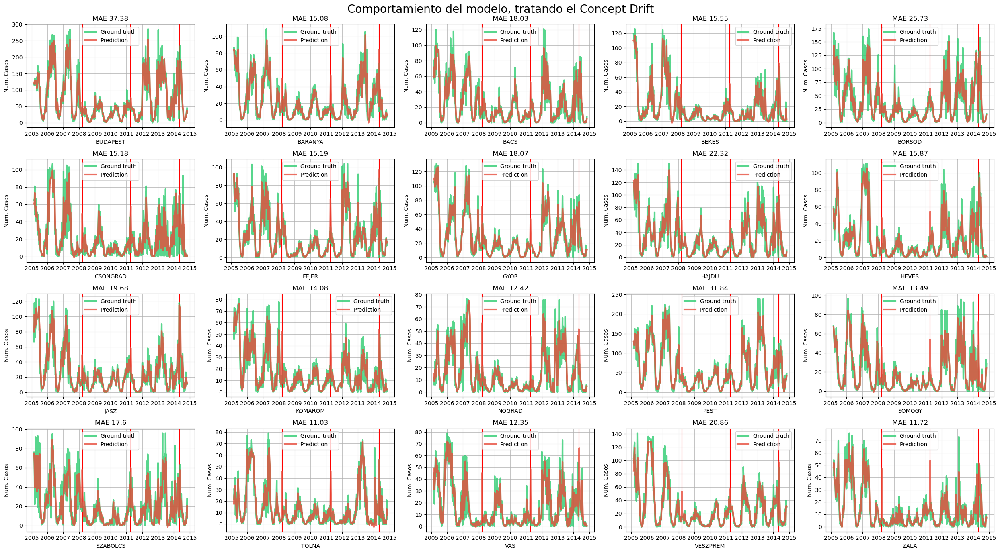

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= df_data_orig_drifted.iloc[:, i]
        media=df_data.mean()
        std=df_data.std()
        outlier_value=media+(3*std)
        model_dummy=time_series.HoltWinters(alpha=0.6,beta=0.04,gamma=0.9)
        label=data_orig.columns[i]
        
        model_s = ( get_ordinal_date|  time_series.SNARIMAX(
                p=4,
                d=0,
                q=9,
                m=52,
                sp=4,
                sq=9,
                regressor=(
                    preprocessing.StandardScaler() | 
                    linear_model.LinearRegression(
                        intercept_init=110,
                        optimizer=optim.SGD(0.001),
                        intercept_lr=0.3
                    )
                )
            )
        )
        evaluate_forecasting_with_drift(model_s,df_data,ax,label,horizonte=8,outlier_value=outlier_value,model="snarimax",check_drift=True)
        i += 1
fig.suptitle("Comportamiento del modelo, tratando el Concept Drift", fontsize=20)
plt.tight_layout()
plt.show()

#### 2.2.5.3 Gráficas y comportamiento del modelo SNARIMAX con horizonte a 3 meses (12 semanas).

##### 2.2.5.3.1 Gráfica y comportamiento de la predicción a 3 meses (12 semenas). Sin tratar el Concept Drift.

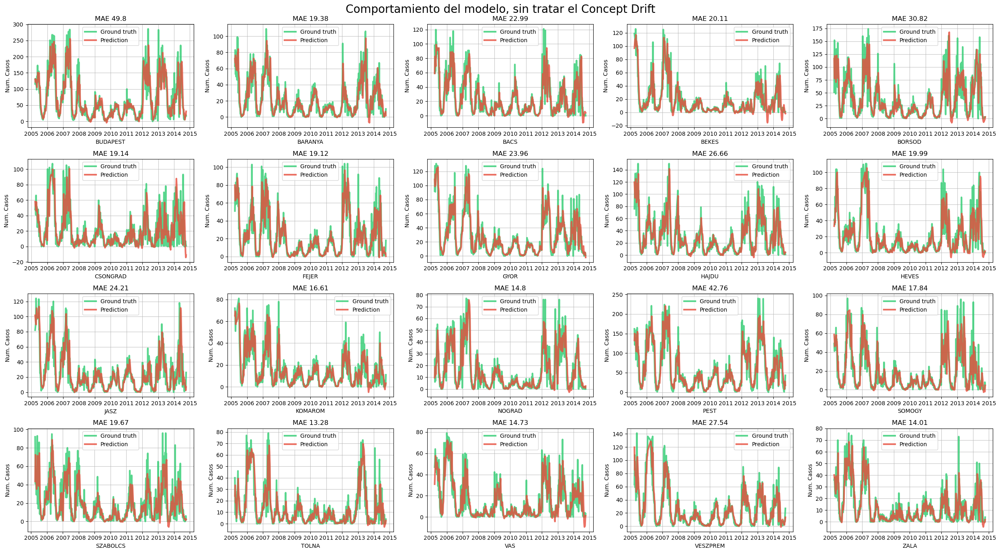

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= df_data_orig_drifted.iloc[:, i]
        media=df_data.mean()
        std=df_data.std()
        outlier_value=media+(3*std)
        model_dummy=time_series.HoltWinters(alpha=0.6,beta=0.04,gamma=0.9)
        label=data_orig.columns[i]
        
        model_s = ( get_ordinal_date|  time_series.SNARIMAX(
                p=4,
                d=0,
                q=9,
                m=52,
                sp=4,
                sq=9,
                regressor=(
                    preprocessing.StandardScaler() | 
                    linear_model.LinearRegression(
                        intercept_init=110,
                        optimizer=optim.SGD(0.001),
                        intercept_lr=0.3
                    )
                )
            )
        )
        evaluate_forecasting_with_drift(model_s,df_data,ax,label,horizonte=12,outlier_value=outlier_value,model="snarimax",check_drift=False)
        i += 1
fig.suptitle("Comportamiento del modelo, sin tratar el Concept Drift", fontsize=20)
plt.tight_layout()
plt.show()

##### 2.2.5.1.2 Gráfica y comportamiento de la predicción a 3 meses (12 semenas).Tratando el Concept Drift.

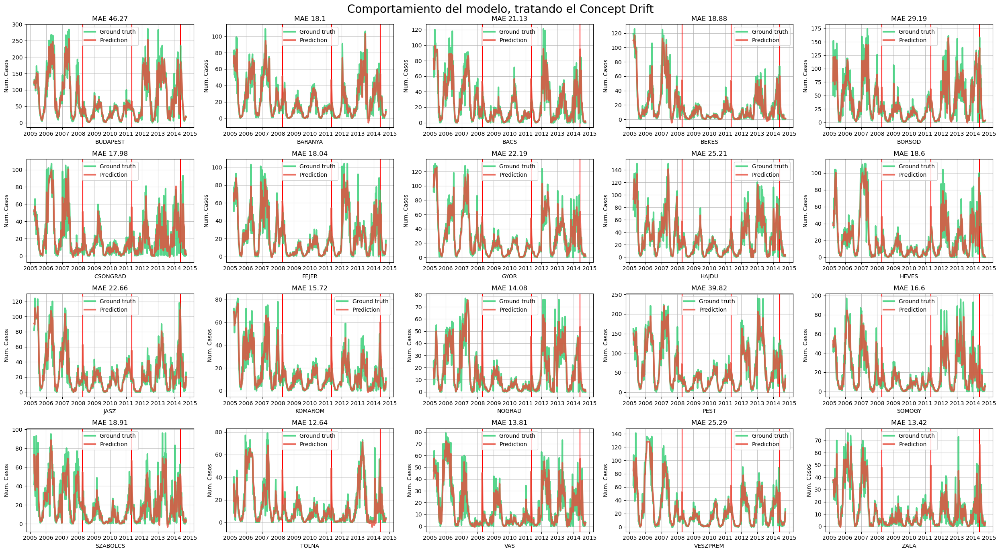

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= df_data_orig_drifted.iloc[:, i]
        media=df_data.mean()
        std=df_data.std()
        outlier_value=media+(3*std)
        model_dummy=time_series.HoltWinters(alpha=0.6,beta=0.04,gamma=0.9)
        label=data_orig.columns[i]
        
        model_s = ( get_ordinal_date|  time_series.SNARIMAX(
                p=4,
                d=0,
                q=9,
                m=52,
                sp=4,
                sq=9,
                regressor=(
                    preprocessing.StandardScaler() | 
                    linear_model.LinearRegression(
                        intercept_init=110,
                        optimizer=optim.SGD(0.001),
                        intercept_lr=0.3
                    )
                )
            )
        )
        evaluate_forecasting_with_drift(model_s,df_data,ax,label,horizonte=12,outlier_value=outlier_value,model="snarimax",check_drift=True)
        i += 1
fig.suptitle("Comportamiento del modelo, tratando el Concept Drift", fontsize=20)
plt.tight_layout()
plt.show()

#### 2.2.5.1 Gráficas y comportamiento del modelo HoltWinter (Base Line) con horizonte a 1 mes (4 semanas).

##### 2.2.5.1.1 Gráfica y comportamiento de la predicción a 1 mes (4 semenas). Sin tratar el Concept Drift.

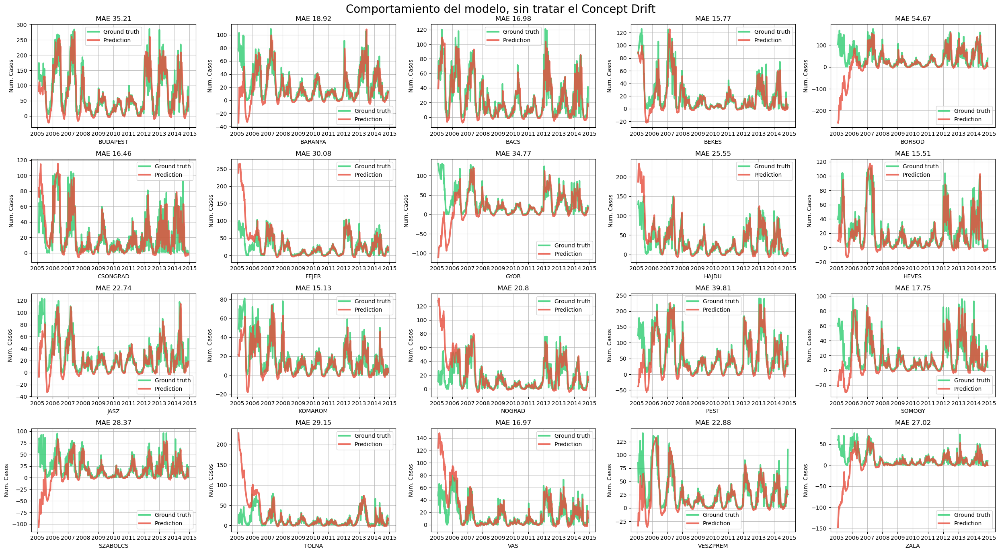

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= df_data_orig_drifted.iloc[:, i]
        media=df_data.mean()
        std=df_data.std()
        outlier_value=media+(3*std)
        model_dummy=time_series.HoltWinters(alpha=0.6,beta=0.04,gamma=0.9)
        label=data_orig.columns[i]
        
        model_s = ( get_ordinal_date|  time_series.SNARIMAX(
                p=4,
                d=0,
                q=9,
                m=52,
                sp=4,
                sq=9,
                regressor=(
                    preprocessing.StandardScaler() | 
                    linear_model.LinearRegression(
                        intercept_init=110,
                        optimizer=optim.SGD(0.001),
                        intercept_lr=0.3
                    )
                )
            )
        )
        evaluate_forecasting_with_drift(model_dummy,df_data,ax,label,horizonte=4,outlier_value=outlier_value,model="baseline",check_drift=False)
        i += 1
fig.suptitle("Comportamiento del modelo, sin tratar el Concept Drift", fontsize=20)
plt.tight_layout()
plt.show()

##### 2.2.5.1.2 Gráfica y comportamiento de la predicción a 1 mes (4 semenas).Tratando el Concept Drift.

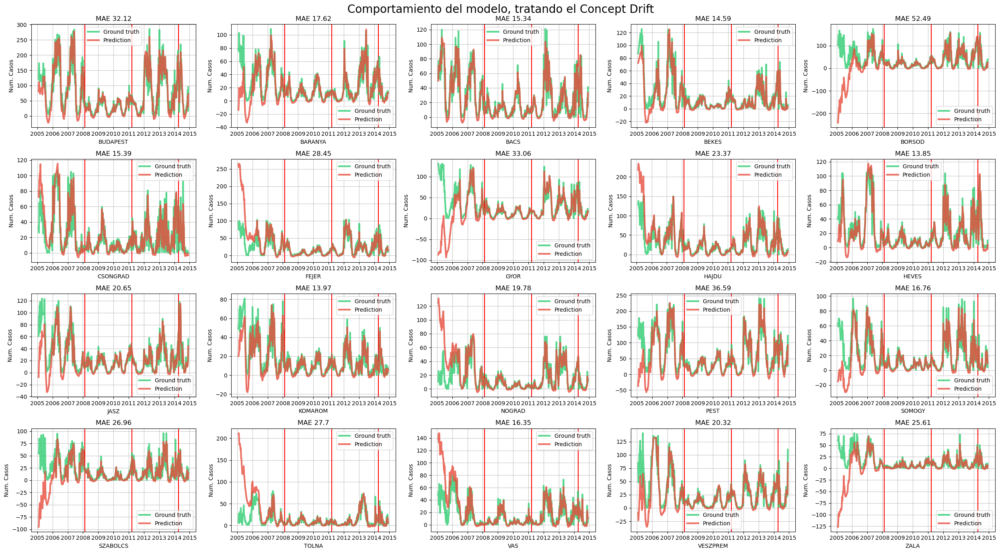

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= df_data_orig_drifted.iloc[:, i]
        media=df_data.mean()
        std=df_data.std()
        outlier_value=media+(3*std)
        model_dummy=time_series.HoltWinters(alpha=0.6,beta=0.04,gamma=0.9)
        label=data_orig.columns[i]
        
        model_s = ( get_ordinal_date|  time_series.SNARIMAX(
                p=4,
                d=0,
                q=9,
                m=52,
                sp=4,
                sq=9,
                regressor=(
                    preprocessing.StandardScaler() | 
                    linear_model.LinearRegression(
                        intercept_init=110,
                        optimizer=optim.SGD(0.001),
                        intercept_lr=0.3
                    )
                )
            )
        )
        evaluate_forecasting_with_drift(model_dummy,df_data,ax,label,horizonte=4,outlier_value=outlier_value,model="baseline",check_drift=True)
        i += 1
fig.suptitle("Comportamiento del modelo, tratando el Concept Drift", fontsize=20)
plt.tight_layout()
plt.show()

#### 2.2.5.2 Gráficas y comportamiento del modelo HoltWinter (Base Line) con horizonte a 2 meses (8 semanas).

##### 2.2.5.2.1 Gráfica y comportamiento de la predicción a 2 meses (8 semenas). Sin tratar el Concept Drift.

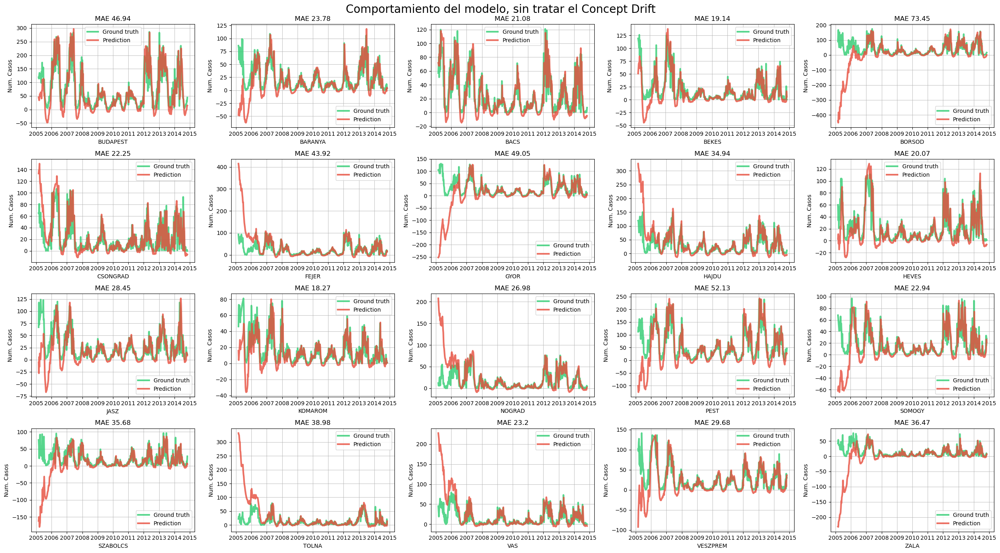

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= df_data_orig_drifted.iloc[:, i]
        media=df_data.mean()
        std=df_data.std()
        outlier_value=media+(3*std)
        model_dummy=time_series.HoltWinters(alpha=0.6,beta=0.04,gamma=0.9)
        label=data_orig.columns[i]
        
        model_s = ( get_ordinal_date|  time_series.SNARIMAX(
                p=4,
                d=0,
                q=9,
                m=52,
                sp=4,
                sq=9,
                regressor=(
                    preprocessing.StandardScaler() | 
                    linear_model.LinearRegression(
                        intercept_init=110,
                        optimizer=optim.SGD(0.001),
                        intercept_lr=0.3
                    )
                )
            )
        )
        evaluate_forecasting_with_drift(model_dummy,df_data,ax,label,horizonte=8,outlier_value=outlier_value,model="baseline",check_drift=False)
        i += 1
fig.suptitle("Comportamiento del modelo, sin tratar el Concept Drift", fontsize=20)
plt.tight_layout()
plt.show()

##### 2.2.5.1.2 Gráfica y comportamiento de la predicción a 2 meses (8 semenas).Tratando el Concept Drift.

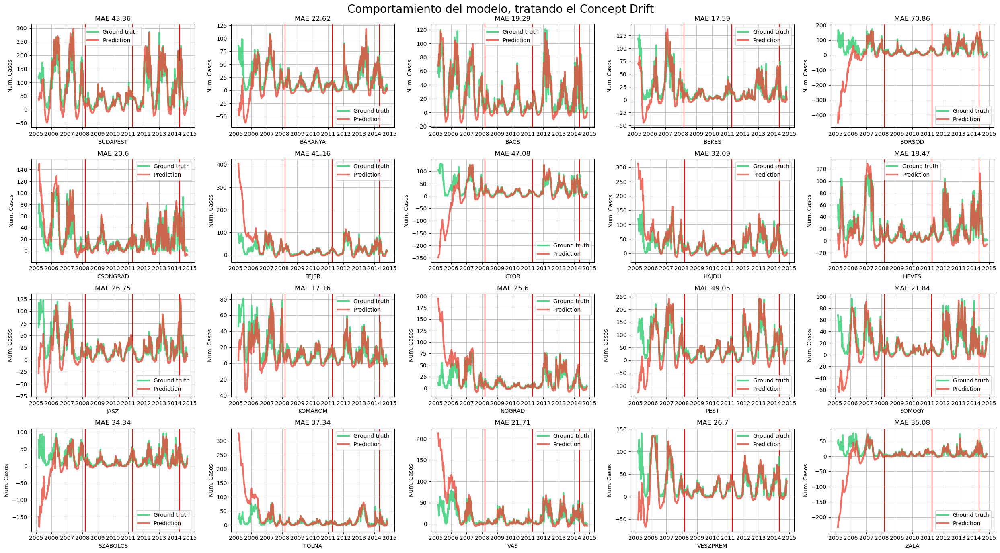

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= df_data_orig_drifted.iloc[:, i]
        media=df_data.mean()
        std=df_data.std()
        outlier_value=media+(3*std)
        model_dummy=time_series.HoltWinters(alpha=0.6,beta=0.04,gamma=0.9)
        label=data_orig.columns[i]
        
        model_s = ( get_ordinal_date|  time_series.SNARIMAX(
                p=4,
                d=0,
                q=9,
                m=52,
                sp=4,
                sq=9,
                regressor=(
                    preprocessing.StandardScaler() | 
                    linear_model.LinearRegression(
                        intercept_init=110,
                        optimizer=optim.SGD(0.001),
                        intercept_lr=0.3
                    )
                )
            )
        )
        evaluate_forecasting_with_drift(model_dummy,df_data,ax,label,horizonte=8,outlier_value=outlier_value,model="baseline",check_drift=True)
        i += 1
fig.suptitle("Comportamiento del modelo, tratando el Concept Drift", fontsize=20)
plt.tight_layout()
plt.show()

#### 2.2.5.3 Gráficas y comportamiento del modelo HoltWinter (Base Line) con horizonte a 3 meses (12 semanas).

##### 2.2.5.3.1 Gráfica y comportamiento de la predicción a 3 meses (12 semenas). Sin tratar el Concept Drift.

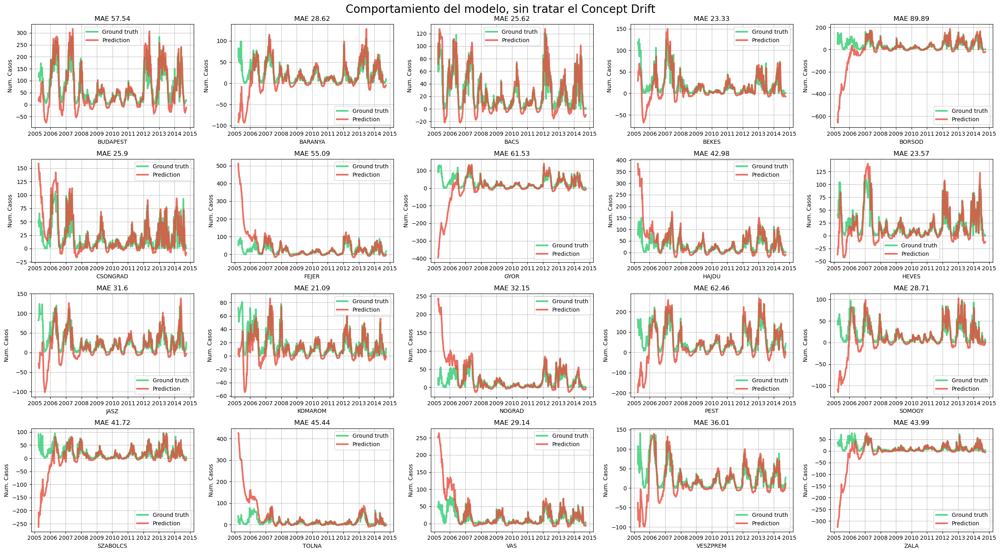

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= df_data_orig_drifted.iloc[:, i]
        media=df_data.mean()
        std=df_data.std()
        outlier_value=media+(3*std)
        model_dummy=time_series.HoltWinters(alpha=0.6,beta=0.04,gamma=0.9)
        label=data_orig.columns[i]
        
        model_s = ( get_ordinal_date|  time_series.SNARIMAX(
                p=4,
                d=0,
                q=9,
                m=52,
                sp=4,
                sq=9,
                regressor=(
                    preprocessing.StandardScaler() | 
                    linear_model.LinearRegression(
                        intercept_init=110,
                        optimizer=optim.SGD(0.001),
                        intercept_lr=0.3
                    )
                )
            )
        )
        evaluate_forecasting_with_drift(model_dummy,df_data,ax,label,horizonte=12,outlier_value=outlier_value,model="baseline",check_drift=False)
        i += 1
fig.suptitle("Comportamiento del modelo, sin tratar el Concept Drift", fontsize=20)
plt.tight_layout()
plt.show()

##### 2.2.5.1.2 Gráfica y comportamiento de la predicción a 3 meses (12 semenas).Tratando el Concept Drift.

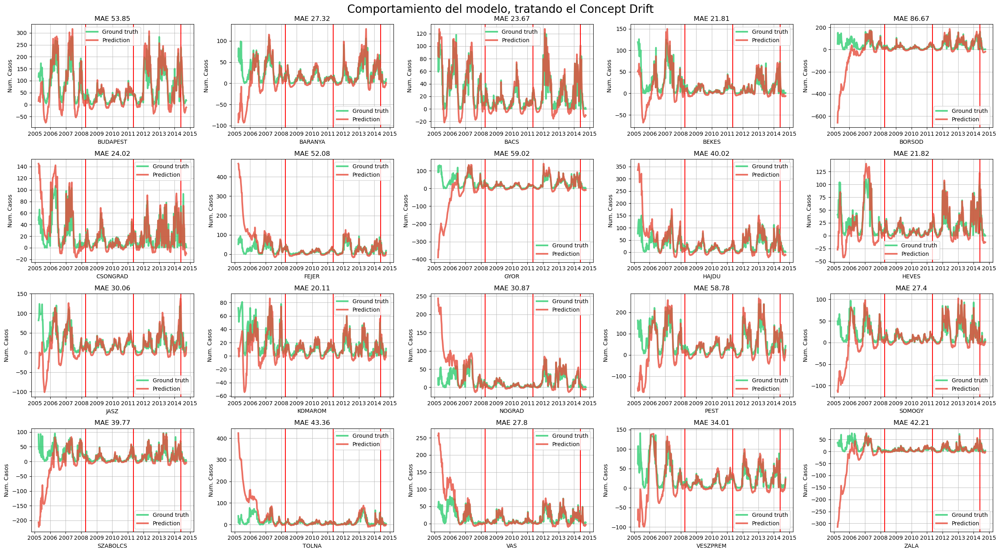

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= df_data_orig_drifted.iloc[:, i]
        media=df_data.mean()
        std=df_data.std()
        outlier_value=media+(3*std)
        model_dummy=time_series.HoltWinters(alpha=0.6,beta=0.04,gamma=0.9)
        label=data_orig.columns[i]
        
        model_s = ( get_ordinal_date|  time_series.SNARIMAX(
                p=4,
                d=0,
                q=9,
                m=52,
                sp=4,
                sq=9,
                regressor=(
                    preprocessing.StandardScaler() | 
                    linear_model.LinearRegression(
                        intercept_init=110,
                        optimizer=optim.SGD(0.001),
                        intercept_lr=0.3
                    )
                )
            )
        )
        evaluate_forecasting_with_drift(model_dummy,df_data,ax,label,horizonte=12,outlier_value=outlier_value,model="baseline",check_drift=True)
        i += 1
fig.suptitle("Comportamiento del modelo, tratando el Concept Drift", fontsize=20)
plt.tight_layout()
plt.show()

### 2.2.6 Gráficas, comparación de la métrica de error seleccionada (MAE)de los distintos horizontes con el Modelo SNARIMAX y Baseline.
Se compara la evolución del error, MAE, de cada uno de los modelos para cada ciudad.En este apartado se puede comprobar que la comparación de los distintos horizontes del modelo SNARIMAX vs distintos horizontes Baseline, en el modelo SNARIMAX se consigue un menor error MAE, tanto en la versión del tratamiento del Concept Drift como sin tratarlo. También se adivina que a menor horizonte, mayor precisión en las predicciones.

#### 2.2.6.1 Gráficas de error  y comportamiento del modelo SNARIMAX con varios horizontes, para cada ciudad sin tratar el Concept Drift.

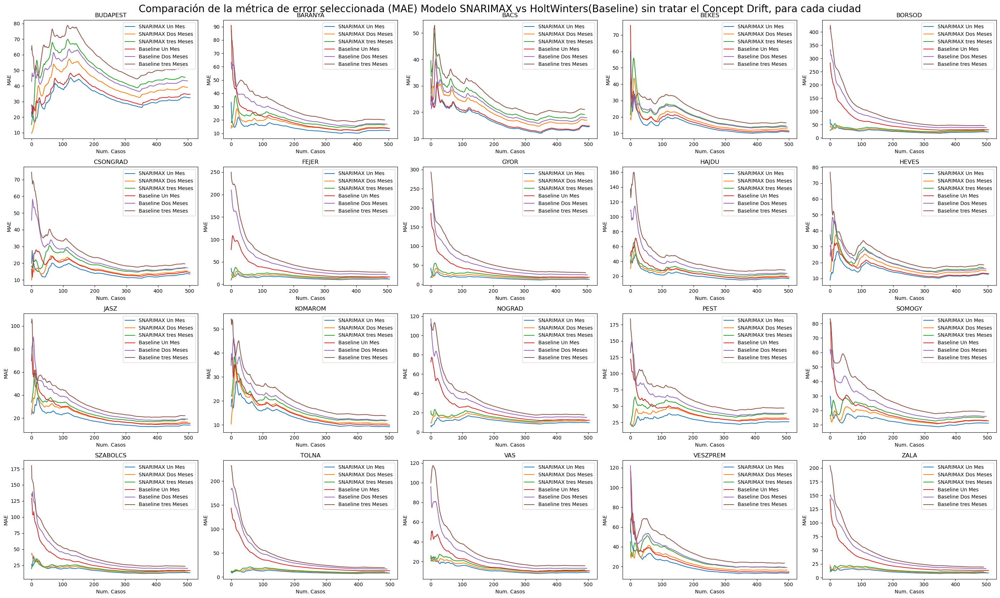

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(28, 17))
i = 0
for row in axes:
    for ax in row:
        label=data_orig.columns[i]
        ax.set_title(label)
        df_error_mae_un_mes_sin_concept[label].plot(ax=ax)
        df_error_mae_dos_meses_sin_concept[label].plot(ax=ax)
        df_error_mae_tres_meses_sin_concept[label].plot(ax=ax)
        df_error_mae_un_mes_baseline_sin_concept[label].plot(ax=ax)
        df_error_mae_dos_meses_baseline_sin_concept[label].plot(ax=ax)
        df_error_mae_tres_meses_baseline_sin_concept[label].plot(ax=ax)
        ax.set_xlabel(label_num_casos)
        ax.set_ylabel("MAE")
        ax.legend(["SNARIMAX Un Mes", "SNARIMAX Dos Meses","SNARIMAX tres Meses","Baseline Un Mes", "Baseline Dos Meses","Baseline tres Meses"]);
        i += 1
fig.suptitle("Comparación de la métrica de error seleccionada (MAE) Modelo SNARIMAX vs HoltWinters(Baseline) sin tratar el Concept Drift, para cada ciudad", fontsize=20)
plt.tight_layout()
plt.show()

#### 2.2.6.2 Gráficas de error  y comportamiento del modelo HoltWinters (Baseline) con varios horizontes , para cada ciudad tratando el Concept Drift.

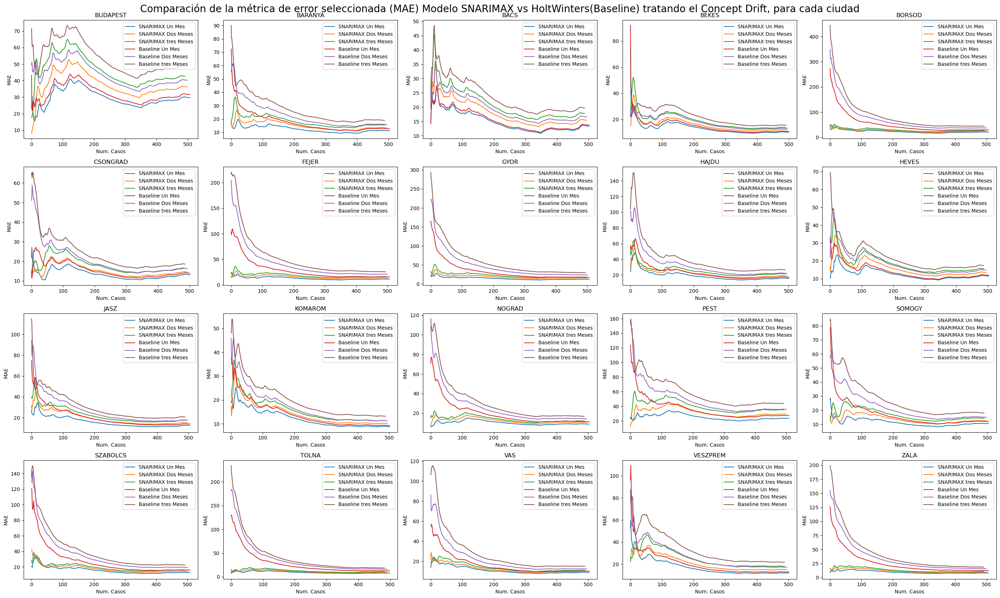

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(28, 17))
i = 0
for row in axes:
    for ax in row:
        label=data_orig.columns[i]
        ax.set_title(label)
        df_error_mae_un_mes_con_concept[label].plot(ax=ax)
        df_error_mae_dos_meses_con_concept[label].plot(ax=ax)
        df_error_mae_tres_meses_con_concept[label].plot(ax=ax)
        df_error_mae_un_mes_baseline_con_concept[label].plot(ax=ax)
        df_error_mae_dos_meses_baseline_con_concept[label].plot(ax=ax)
        df_error_mae_tres_meses_baseline_con_concept[label].plot(ax=ax)
        ax.set_xlabel(label_num_casos)
        ax.set_ylabel("MAE")
        ax.legend(["SNARIMAX Un Mes", "SNARIMAX Dos Meses","SNARIMAX tres Meses","Baseline Un Mes", "Baseline Dos Meses","Baseline tres Meses"]);
        i += 1
fig.suptitle("Comparación de la métrica de error seleccionada (MAE) Modelo SNARIMAX vs HoltWinters(Baseline) tratando el Concept Drift, para cada ciudad", fontsize=20)
plt.tight_layout()
plt.show()

### 2.2.7  Graficas de cada modelo **para cada ciudad** comparando la evolución del error tratando el Concept Drift vs sin Tratarlo.
Se puede ver que as predicciones a mas corto plazo presentan menos error y que a su vez, el tratamiento del Concept drif, nos conduce a unas predicciones mas precisas, menos error para cada  uno de los diferentes modelos aunque el modelo SNARIMAX, saca mejores prestaciones que el HoltWinters (Base Line)

#### 2.2.4.1 Modelo SNARIMAX con los distintos horizontes (1,2 y 3 meses) tratando el Concept Drift vs Sin tratar.

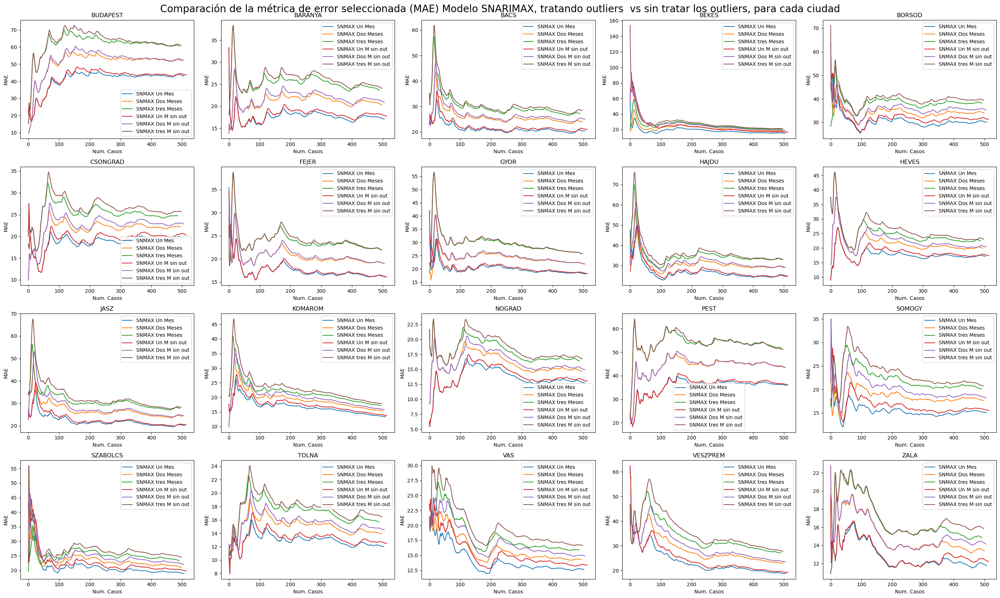

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(28, 17))
i = 0
for row in axes:
    for ax in row:
        label=data_orig.columns[i]
        ax.set_title(label)
        df_error_mae_un_mes[label].plot(ax=ax)
        df_error_mae_dos_meses[label].plot(ax=ax)
        df_error_mae_tres_meses[label].plot(ax=ax)
        df_error_mae_un_mes_sin_outliers[label].plot(ax=ax)
        df_error_mae_dos_meses_sin_outliers[label].plot(ax=ax)
        df_error_mae_tres_meses_sin_outliers[label].plot(ax=ax)
        ax.set_xlabel(label_num_casos)
        ax.set_ylabel("MAE")
        ax.legend(["SNMAX Un Mes", "SNMAX Dos Meses","SNMAX tres Meses","SNMAX Un M sin out", "SNMAX Dos M sin out","SNMAX tres M sin out"]);
        i += 1
fig.suptitle("Comparación de la métrica de error seleccionada (MAE) Modelo SNARIMAX, tratando outliers  vs sin tratar los outliers, para cada ciudad", fontsize=20)
plt.tight_layout()
plt.show()

#### 2.2.4.2 Modelo Baseline con los distintos horizontes (1,2 y 3 meses) tratando el Concept Drift vs Sin tratar.

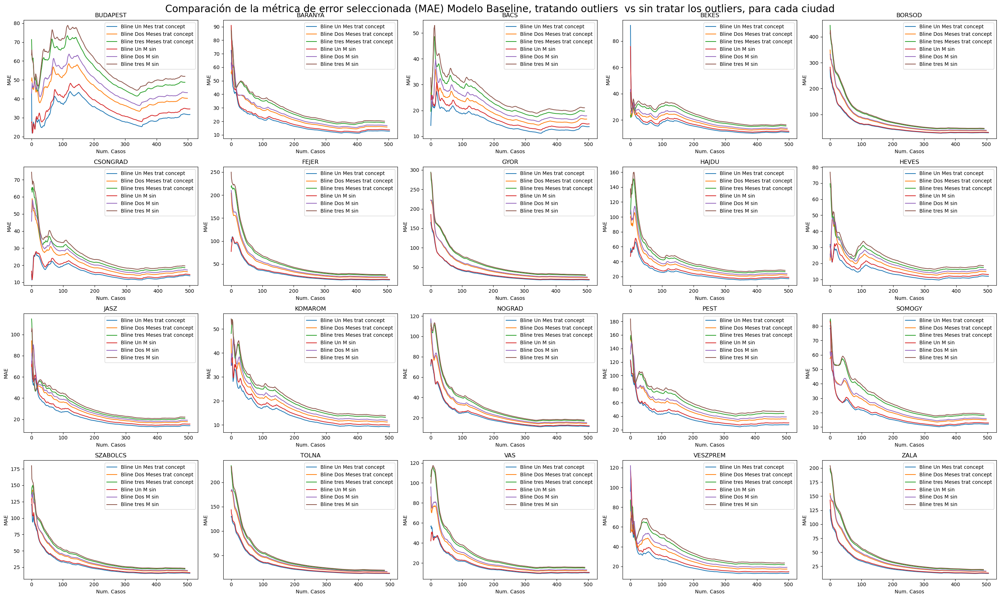

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(28, 17))
i = 0
for row in axes:
    for ax in row:
        label=data_orig.columns[i]
        ax.set_title(label)
        df_error_mae_un_mes_baseline_con_concept[label].plot(ax=ax)
        df_error_mae_dos_meses_baseline_con_concept[label].plot(ax=ax)
        df_error_mae_tres_meses_baseline_con_concept[label].plot(ax=ax)
        df_error_mae_un_mes_baseline_sin_concept[label].plot(ax=ax)
        df_error_mae_dos_meses_baseline_sin_concept[label].plot(ax=ax)
        df_error_mae_tres_meses_baseline_sin_concept[label].plot(ax=ax)
        ax.set_xlabel(label_num_casos)
        ax.set_ylabel("MAE")
        ax.legend(["Bline Un Mes trat concept", "Bline Dos Meses trat concept","Bline tres Meses trat concept","Bline Un M sin", "Bline Dos M sin","Bline tres M sin"]);
        i += 1
fig.suptitle("Comparación de la métrica de error seleccionada (MAE) Modelo Baseline, tratando outliers  vs sin tratar los outliers, para cada ciudad", fontsize=20)
plt.tight_layout()
plt.show()

### 2.2.8 Tabla de Resultados

In [ ]:
df_datos_largo_plazo.sort_index(ascending=True)

,BUDAPEST,BARANYA,BACS,BEKES,BORSOD,CSONGRAD,FEJER,GYOR,HAJDU,HEVES,JASZ,KOMAROM,NOGRAD,PEST,SOMOGY,SZABOLCS,TOLNA,VAS,VESZPREM,ZALA
"1 MAE Datos sin drift y sin tratar outliers con horizonte= 12 semanas, modelo = baseline",74.22,36.48,35.51,80.33,57.38,34.93,87.64,59.85,85.85,30.6,60.59,27.31,36.34,76.4,34.01,47.17,50.84,34.8,44.49,46.47
"1 MAE Datos sin drift y sin tratar outliers con horizonte= 12 semanas, modelo = snarimax",62.91,25.99,31.11,28.72,40.05,26.35,24.08,30.03,36.38,25.86,32.98,23.21,18.48,53.8,23.43,27.02,17.77,19.71,35.52,17.08
"1 MAE Datos sin drift y sin tratar outliers con horizonte= 4 semanas, modelo = baseline",45.55,23.68,23.12,53.16,38.94,22.3,54.59,37.12,54.4,20.16,40.54,19.0,23.73,48.62,21.24,32.87,32.57,21.9,27.96,29.18
"1 MAE Datos sin drift y sin tratar outliers con horizonte= 4 semanas, modelo = snarimax",41.88,18.1,22.03,24.06,32.09,19.39,17.61,20.56,27.33,18.25,22.88,17.4,13.87,35.91,16.67,22.5,13.33,15.37,24.6,13.05
"1 MAE Datos sin drift y sin tratar outliers con horizonte= 8 semanas, modelo = baseline",60.24,30.0,29.18,66.31,49.83,29.49,72.91,49.43,72.74,25.7,52.97,23.39,30.39,63.23,26.9,40.59,43.22,29.16,34.54,38.75
"1 MAE Datos sin drift y sin tratar outliers con horizonte= 8 semanas, modelo = snarimax",51.75,21.8,26.77,26.36,35.64,22.45,20.73,24.74,32.11,22.4,28.28,20.32,16.38,44.22,20.12,24.94,15.59,17.35,29.88,15.25
"2 MAE Datos sin drift y tratando outliers con horizonte= 12 semanas, modelo = baseline",70.98,35.31,33.92,29.0,55.48,33.06,56.11,64.87,93.39,28.87,63.6,26.03,35.64,75.17,32.94,47.86,50.0,32.52,41.86,46.74
"2 MAE Datos sin drift y tratando outliers con horizonte= 12 semanas, modelo = snarimax",61.61,25.32,30.17,25.6,38.42,25.27,23.85,29.85,34.99,24.74,31.19,21.78,17.98,53.71,22.11,25.22,17.2,18.23,33.63,16.79
"2 MAE Datos sin drift y tratando outliers con horizonte= 4 semanas, modelo = baseline",44.03,23.13,22.17,19.78,36.9,21.29,34.14,38.29,57.74,19.26,41.79,18.44,23.36,47.7,20.7,32.79,32.06,20.5,26.91,29.19
"2 MAE Datos sin drift y tratando outliers con horizonte= 4 semanas, modelo = snarimax",40.9,17.6,21.34,18.5,30.73,18.69,17.5,20.14,26.76,17.58,22.14,16.67,13.52,35.42,15.52,21.05,12.91,14.2,23.68,12.84


### 2.2.9 Conclusiones
* Para cada ciudad: 
>En este caso tenemos dos modelos con varios horizontes.El modelo **SNARIMAX** que ha sido configurado con sus parámetros a partir de los plots de Autocorrlación (ACF) y Autocorrelación Parcial (PACF)y otro modelo tomado como Baseline que es el **Holtwinter**, en el que también se han ajustado sus parámetros para un buen rendimiento. Lo primero que hay que destacar que a mayor horizonte los modelos predicen peor, tienen más error. Obviamente como en el caso del Nowcasting si se tratan los outliers se obtienen mejores prestaciones que si no se hace. Lo mismo ocurre con el drift. Se ha introducido un drift artificial para hacer estas comprobaciones con el detector de drifts ADWIN. Cada vez que se detecta un drift, tanto el modelo como el detector son reiniciados.


* Comparando ciudades: 
> Comparando las mediciones entre ciudades, las ciudades que menor MAE presentan independientemente del modelo usado, aunque por supuesto hay diferencias entre modelos y siguen siendo los menores MAE aquellos que tratan los outliers y el drift. Como en la comparación en cada ciudad el modelo para cada ciudad el mejor modelo es el **SNARIMAX**
Al igual que con el Nowcating, las mejores ciudades, son aquellas que presentan una menor dispersión, menor desviación tipica y menor media, en los datos. 
Estas ciudades son aquellas que presentan una menor población o han contraido un menor número de casos de varicela. A mayor dispersión en los datos, mayor es el error.

